# Single Family Real Estate Trends Charlottesville By Neighborhood

In [213]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import folium
import string
from folium import plugins
%matplotlib inline
import locale 
from locale import atof
#locale.setlocale(locale.LC_ALL, 'en_US.UTF8')
from shapely.geometry import Point
from shapely.geometry.polygon import Polygon
import json
from datetime import datetime

import plotly.express as px
#from varname import nameof

sns.set()
plt.rcParams["figure.figsize"] = (20,7)

In [2]:
import sys
!{sys.executable} -m pip install plotly==4.9.0

In [3]:
!{sys.executable} -m pip install python-varname

In [153]:
!{sys.executable} -m pip install git+https://github.com/python-visualization/folium.git@master

  Cloning https://github.com/python-visualization/folium.git (to revision master) to /private/var/folders/kt/r_75997j2hb_y_hm62h1_32w0000gn/T/pip-req-build-3k5p_751
  Running command git clone -q https://github.com/python-visualization/folium.git /private/var/folders/kt/r_75997j2hb_y_hm62h1_32w0000gn/T/pip-req-build-3k5p_751
  Created wheel for folium: filename=folium-0.11.0+19.g46f820e-py2.py3-none-any.whl size=97533 sha256=2f8d2ef215a71d311bb7aca6231e580d596aea63ee962f903a72f0e3bd6ed57e
  Stored in directory: /private/var/folders/kt/r_75997j2hb_y_hm62h1_32w0000gn/T/pip-ephem-wheel-cache-jv478evi/wheels/e0/25/02/0a1bdec416fa3da51004a9e19f70e52923ef47eccb37fe7222
Successfully built folium
  Attempting uninstall: folium
    Found existing installation: folium 0.11.0
    Uninstalling folium-0.11.0:
      Successfully uninstalled folium-0.11.0


In [4]:
df=pd.read_csv('csv/SingleFamily20yrs.csv')
sf20=df[['SaleDate', 'ParcelNumber', 'SaleAmount', 'Address1', 'Latitude', 'Longitude']]
sf20=sf20.rename(columns={'Address1':'Address'})
sf20.head()

,SaleDate,ParcelNumber,SaleAmount,Address,Latitude,Longitude
0,2003-01-31,010006000,545000,2028 BARRACKS RD,38.050765,-78.498080
1,2018-10-31,010010000,575000,1851 WESTVIEW RD,38.048508,-78.498668
2,2018-01-10,010011000,970000,1855 WESTVIEW RD,38.049037,-78.498346
3,2015-05-04,010012000,512000,1857 WESTVIEW RD,38.049108,-78.499057
4,2007-06-26,010014000,975000,1885 WESTVIEW RD,38.049347,-78.499412


# Creating Neighborhood Polygons

In [5]:
neighs=[]

Barracks Road

In [6]:
br_v=[[-78.499061309259602,38.052791471501386],[-78.503251832184347,38.048837041487886],[-78.503853740772357,38.047884967342107],[-78.506089130241222,38.041458465157937],[-78.506540981905417,38.041686494869943],[-78.512200353129401,38.044128378667089],[-78.511764806285328,38.04445022344099],[-78.511162919496499,38.044688302514658],[-78.510947914287868,38.044688322429977],[-78.509056097619407,38.044688480969441],[-78.506949357945643,38.045198659879958],[-78.506046413227878,38.045198709043632],[-78.505874436745628,38.045300703182214],[-78.505143599315232,38.046592828133186],[-78.504928657029481,38.0471028744808],[-78.505573642675543,38.047816881646],[-78.51049931639551,38.051524764725791],[-78.507618180840083,38.056255268581559],[-78.503833135187577,38.05707728976251],[-78.500843964002641,38.054753438250337],[-78.499061309259602,38.052791471501386]]
barracks_road= Polygon(br_v)
neighs.append(barracks_road)

Lewis Mountain

In [7]:
lm_v=[[-78.512200353129401,38.044128378667089],[-78.506540981905417,38.041686494869943],[-78.506089130241222,38.041458465157937],[-78.506669007421308,38.039818781577175],[-78.508163965106306,38.035865186148271],[-78.512149869883316,38.036898023828527],[-78.513295665089416,38.0371992734784],[-78.514517746393011,38.0369526789692],[-78.515674927428194,38.036863205714688],[-78.51692515471197,38.039994526623587],[-78.516209200526532,38.040429973871895],[-78.517311385105714,38.04117214004652],[-78.516811600017888,38.04222990795779],[-78.515984443636839,38.043476805687867],[-78.513898542117403,38.044132861161657],[-78.514463851674506,38.044785457775006],[-78.512200353129401,38.044128378667089]]
lewis_mountain=Polygon(lm_v)
neighs.append(lewis_mountain)

North Downtown

In [8]:
nd_v=[[-78.485518026971064,38.029651100743202],[-78.485175649731403,38.030562535712789],[-78.485065861401935,38.031678025783862],[-78.484709360002043,38.032658161607188],[-78.484324854966147,38.033197506302407],[-78.483752172116724,38.033581209046162],[-78.485636933558226,38.035045309084182],[-78.484996046716574,38.035646216803592],[-78.483544495434572,38.037021077645925],[-78.482835613268591,38.03768687899214],[-78.480965849212424,38.039450587497882],[-78.481290535085662,38.039674738411968],[-78.481412036625073,38.039759196332142],[-78.481700170902641,38.039955578535533],[-78.481991613948338,38.040115631194702],[-78.4810524259955,38.041431057710554],[-78.47843116486932,38.045131093000542],[-78.477512098931911,38.044358672416834],[-78.47618454159074,38.043693833525261],[-78.475401038020436,38.043236002508095],[-78.474271138477647,38.042122599465884],[-78.473469626513833,38.041416844542461],[-78.472191665733376,38.040576860302657],[-78.470864823703238,38.039796245775108],[-78.469458917082079,38.039098552193451],[-78.46790721794774,38.038872013437903],[-78.467444452283786,38.038901132843044],[-78.468010333226118,38.038395558146185],[-78.468451534531312,38.037955109979848],[-78.468961959275603,38.037520664376146],[-78.469571353133233,38.03685596351378],[-78.470162394133638,38.03604330108903],[-78.469978595152014,38.035947886921051],[-78.470452029559581,38.035230533803876],[-78.470189880846632,38.035113654356032],[-78.470605535543555,38.034487480201733],[-78.472224435356978,38.035182547646649],[-78.473491895858032,38.033361120323313],[-78.472769003249098,38.033071750084034],[-78.473870147382968,38.031373601691513],[-78.475279128086015,38.029601666500987],[-78.476231428951607,38.028931782839265],[-78.476645339997219,38.028502775666041],[-78.477965590662492,38.028674568894914],[-78.480686679379872,38.025149045446099],[-78.481242831577589,38.025703743042342],[-78.481570516862178,38.026195107674148],[-78.482812415573534,38.027450844261494],[-78.483140180473214,38.027669252471178],[-78.486073000605003,38.02870681994105],[-78.485518026971064,38.029651100743202]]
north_downtown=Polygon(nd_v)
neighs.append(north_downtown)

Johnson Village

In [9]:
jv_v=[[-78.510685723998904,38.019730212985408],[-78.510133975686074,38.020937815311406],[-78.509786919818438,38.021428691909058],[-78.508443679465472,38.022522388987532],[-78.506551944511088,38.023779488772597],[-78.505687607673266,38.024112485352489],[-78.503216013002501,38.02425811546459],[-78.503160469032466,38.024204569996392],[-78.503059783022508,38.023796105445989],[-78.502972999102269,38.02378237765069],[-78.502601558818085,38.023566825476749],[-78.500907539179693,38.022467077881203],[-78.500279238177939,38.022318110544624],[-78.500060548297583,38.022189048878325],[-78.499876571723263,38.022055181345848],[-78.499866158351949,38.021834128342022],[-78.499657884137676,38.021744196427676],[-78.499564163071412,38.021330923074949],[-78.499578049404846,38.021072799062175],[-78.499342009619767,38.020801630405636],[-78.499331596522723,38.020746710325959],[-78.499331597484712,38.020638929779608],[-78.499328127226576,38.020535268211525],[-78.499171927256342,38.0202386990712],[-78.49885258408861,38.019949679744627],[-78.498455978730007,38.019516630738394],[-78.497491941610278,38.018437984438123],[-78.497346170556611,38.018028140238968],[-78.496816286602993,38.01781432341555],[-78.497593695509224,38.01685134526393],[-78.497710666742805,38.016912583476028],[-78.497849505090727,38.016990847198464],[-78.497898101030884,38.016931122455652],[-78.498144543973979,38.016898174478229],[-78.498595778052476,38.016780102415737],[-78.498568011651358,38.016692916421398],[-78.499085197556568,38.016186283486263],[-78.49922979927203,38.016124334614659],[-78.499442709297469,38.016095667494881],[-78.499928646084342,38.016091549758663],[-78.500369460551326,38.016173929375228],[-78.500546480111311,38.016112143562808],[-78.500907461934915,38.016123125381313],[-78.501105308094751,38.016149897266146],[-78.501271916025985,38.01620344271624],[-78.501712730633457,38.016198631686514],[-78.501924461851587,38.016250116063389],[-78.502163969536085,38.016587184133165],[-78.502459008844895,38.016718300165302],[-78.502736689396968,38.016720353619611],[-78.502938009531505,38.016765657915094],[-78.502990076991495,38.016824009230021],[-78.503104630686934,38.017072519753214],[-78.504458330249548,38.017086206858224],[-78.505110901052845,38.017355975644598],[-78.505635050484145,38.017661445026775],[-78.506002997658015,38.017859139377812],[-78.506461191581593,38.018022502677816],[-78.50713112172177,38.018172121721364],[-78.507755935919675,38.01837391400516],[-78.507958733998251,38.018862936375392],[-78.510685723998904,38.019730212985408]]
johnson_village=Polygon(jv_v)
neighs.append(johnson_village)

Fry's Spring

In [10]:
fs_v=[[-78.505475153569321,38.028269932619224],[-78.50453707762567,38.026628636264135],[-78.503573112572099,38.025732101468883],[-78.503216013002501,38.02425811546459],[-78.505687607673266,38.024112485352489],[-78.506551944511088,38.023779488772597],[-78.508443679465472,38.022522388987532],[-78.509786919818438,38.021428691909058],[-78.510133975686074,38.020937815311406],[-78.510685723998904,38.019730212985408],[-78.507958733998251,38.018862936375392],[-78.507755935919675,38.01837391400516],[-78.50713112172177,38.018172121721364],[-78.506461191581593,38.018022502677816],[-78.506002997658015,38.017859139377812],[-78.505635050484145,38.017661445026775],[-78.505110901052845,38.017355975644598],[-78.504458330249548,38.017086206858224],[-78.503104630686934,38.017072519753214],[-78.502990076991495,38.016824009230021],[-78.502938009531505,38.016765657915094],[-78.502736689396968,38.016720353619611],[-78.502459008844895,38.016718300165302],[-78.502163969536085,38.016587184133165],[-78.501924461851587,38.016250116063389],[-78.501712730633457,38.016198631686514],[-78.501271916025985,38.01620344271624],[-78.501105308094751,38.016149897266146],[-78.500907461934915,38.016123125381313],[-78.500546480111311,38.016112143562808],[-78.500369460551326,38.016173929375228],[-78.499928646084342,38.016091549758663],[-78.499442709297469,38.016095667494881],[-78.49922979927203,38.016124334614659],[-78.499085197556568,38.016186283486263],[-78.498568011651358,38.016692916421398],[-78.498595778052476,38.016780102415737],[-78.498144543973979,38.016898174478229],[-78.497898101030884,38.016931122455652],[-78.497849505090727,38.016990847198464],[-78.497710666742805,38.016912583476028],[-78.497593695509224,38.01685134526393],[-78.498205653090452,38.016095518024024],[-78.499052581304582,38.015319698600798],[-78.500098443986161,38.014390041604607],[-78.502635660930935,38.012160528045328],[-78.503465286140653,38.011440502955416],[-78.505620751210927,38.010303846855052],[-78.506915221358881,38.010681108273488],[-78.507567987990114,38.010950507262102],[-78.507908583392904,38.011062769556837],[-78.508220771794171,38.011017851172355],[-78.508418115170429,38.011299468280207],[-78.508419133543669,38.011404612955523],[-78.50864702222546,38.01139289864949],[-78.508921826171871,38.011303248626575],[-78.509330621628692,38.010827827941824],[-78.509724868906588,38.010613552654952],[-78.510093739912634,38.010119541982391],[-78.510175023223326,38.009861382488239],[-78.51050781756706,38.009791275408396],[-78.511066419534941,38.009760002738851],[-78.51131438977022,38.009693745662368],[-78.511508780726047,38.009682029055043],[-78.511817089153965,38.009732662840676],[-78.512400191849224,38.009693637741925],[-78.512855972880828,38.009759823312628],[-78.51334527388363,38.009783138145337],[-78.513794355717806,38.009837650327022],[-78.514022259991762,38.009938924144848],[-78.514250158197882,38.010005158411367],[-78.514726027346541,38.010016771172424],[-78.514886888600657,38.009989483308829],[-78.515161698089699,38.009989448700743],[-78.515402991131197,38.010040081713193],[-78.515570556313207,38.010040059961405],[-78.515952790591015,38.009908310724803],[-78.516106752474428,38.010078954685852],[-78.516281035728667,38.010168560857544],[-78.5165893789097,38.010195786278004],[-78.5168708849708,38.010184048791672],[-78.517159101038089,38.010222973594495],[-78.51734108696094,38.010295771513498],[-78.517565691636293,38.010360352310833],[-78.517715446490698,38.010480083734208],[-78.518324006805472,38.010500257383242],[-78.518607840901609,38.010634960234576],[-78.518948445750141,38.010724701196501],[-78.519207914502203,38.010713675659836],[-78.519360926198573,38.010932617861585],[-78.51933913068109,38.011203432998023],[-78.519251799589966,38.011445453045695],[-78.518836734380798,38.011595341633061],[-78.518793082363587,38.011773976489792],[-78.518793150510447,38.012044787996679],[-78.51885697653556,38.012312651186342],[-78.51880051614863,38.012488459632578],[-78.518803379199213,38.012693778306399],[-78.518837097714723,38.013035843347808],[-78.518772927830739,38.013335278264677],[-78.518744811506309,38.013602084875473],[-78.518969852365146,38.014246784545776],[-78.51902140138057,38.014680261089225],[-78.518984326390282,38.01506761875951],[-78.518934803893501,38.01537163703923],[-78.51895973068325,38.015803113067456],[-78.519210987232086,38.016857264448618],[-78.51928857167475,38.017288731682591],[-78.519641946206136,38.017641700373602],[-78.519747097410018,38.017691358235417],[-78.519784546347466,38.017808386731801],[-78.520144168265162,38.018270204421569],[-78.520615606179589,38.018633200484821],[-78.520621499074963,38.018730051002379],[-78.520717117861977,38.018944222682855],[-78.521235903894919,38.019045211850248],[-78.521366210198408,38.018926259198999],[-78.521558262740427,38.018672274281215],[-78.521657492857258,38.018642819156028],[-78.52190556916338,38.018632970638826],[-78.522215609953619,38.018524967923469],[-78.52235199094109,38.018299248420185],[-78.522513192997323,38.018201103400308],[-78.522724180230753,38.018593577157894],[-78.522848315146874,38.018848657155338],[-78.522922798887436,38.019054702936749],[-78.523357197241594,38.020016268748542],[-78.523394641692406,38.020761993060376],[-78.523394727772697,38.02103675790913],[-78.523510555744295,38.021347829569926],[-78.523724303625073,38.022299935345615],[-78.514978054890406,38.025174189509663],[-78.510461071012415,38.026664565989961],[-78.505475153569321,38.028269932619224]]
frys_spring=Polygon(fs_v)
neighs.append(frys_spring)

10th & Page

In [11]:
tp_v=[[-78.494403925695678,38.031400467756278],[-78.495682714660688,38.031529856983106],[-78.496498694805354,38.031677590502738],[-78.497911247072068,38.032163251845077],[-78.498511777556061,38.032581172941903],[-78.498913349073618,38.032927775983772],[-78.497793488465248,38.033262249414804],[-78.496889967257303,38.033064298457212],[-78.496355145136334,38.034417725832739],[-78.494030026192419,38.033989807381637],[-78.493408468566358,38.035166430119993],[-78.494987564955295,38.035852399252455],[-78.493493876178775,38.039154620111781],[-78.492611209483982,38.038827879215468],[-78.491612232287466,38.038551018147146],[-78.490915247519467,38.03864375390728],[-78.490025376976874,38.038052500164099],[-78.489315821354211,38.037694060446896],[-78.488540967912485,38.037089679857118],[-78.487816360543846,38.03651731742363],[-78.486436441606259,38.035571423737046],[-78.488245318866021,38.034079528722785],[-78.490609946226584,38.032617636678772],[-78.493302536090283,38.031360786410467],[-78.493801899534958,38.031408483771429],[-78.494403925695678,38.031400467756278]]
ten_page=Polygon(tp_v)
neighs.append(ten_page)

Jefferson Park Avenue

In [12]:
jpa_v=[[-78.523773369656681,38.022571559850739],[-78.523434359498722,38.023108250050264],[-78.523313354630574,38.023568228514094],[-78.523337848026813,38.024411492225902],[-78.523000765741799,38.026398231200844],[-78.520051337380181,38.026102717450776],[-78.520230351798958,38.028508150972058],[-78.519705454333973,38.028513868086641],[-78.51924783503236,38.028517704784832],[-78.519730724313632,38.029816480427122],[-78.518196286658537,38.029882628064435],[-78.518248265456904,38.029492002755447],[-78.518005045057492,38.028627738493753],[-78.5165053343935,38.02864168531007],[-78.516231088305886,38.028674674843835],[-78.515210430571898,38.028583505031499],[-78.514464069925708,38.028708540517279],[-78.512377860937789,38.029918384812802],[-78.510617930071149,38.031185829304981],[-78.509615574835763,38.032169116002898],[-78.509270291616232,38.032565224821383],[-78.509084084150743,38.032988670625492],[-78.509038457359864,38.032637214979474],[-78.508805842262632,38.032274075300492],[-78.508360632691904,38.032008432838424],[-78.507715692801696,38.032017400750092],[-78.507103673852598,38.032123186814019],[-78.504754319006892,38.032031971943731],[-78.502771969971647,38.032081434829699],[-78.501838078717,38.032140519115067],[-78.499855723996291,38.032647854725745],[-78.498913349073618,38.032927775983772],[-78.498511777556061,38.032581172941903],[-78.497911247072068,38.032163251845077],[-78.496498694805354,38.031677590502738],[-78.495682714660688,38.031529856983106],[-78.494403925695678,38.031400467756278],[-78.493801899534958,38.031408483771429],[-78.493302536090283,38.031360786410467],[-78.49693180377794,38.030485650278443],[-78.502372838382385,38.029186097932957],[-78.505475153569321,38.028269932619224],[-78.510461071012415,38.026664565989961],[-78.514978054890406,38.025174189509663],[-78.523724303625073,38.022299935345615],[-78.523742484116099,38.022380993637697],[-78.523773369656681,38.022571559850739]]
jefferson_park_avenue=Polygon(jpa_v)
neighs.append(jefferson_park_avenue)

Starr Hill

In [13]:
sh_v=[[-78.486436441606259,38.035571423737046],[-78.485636933558226,38.035045309084182],[-78.483752172116724,38.033581209046162],[-78.484324854966147,38.033197506302407],[-78.484709360002043,38.032658161607188],[-78.485065861401935,38.031678025783862],[-78.485175649731403,38.030562535712789],[-78.485518026971064,38.029651100743202],[-78.487972300832311,38.030381807068984],[-78.489231921139705,38.030830347688834],[-78.49140979165243,38.031194670099836],[-78.493053724270283,38.031318209342594],[-78.493302536090283,38.031360786410467],[-78.490609946226584,38.032617636678772],[-78.488245318866021,38.034079528722785],[-78.486436441606259,38.035571423737046]]
starr_hill=Polygon(sh_v)
neighs.append(starr_hill)

Fifeville

In [14]:
f_v=[[-78.503216013002501,38.02425811546459],[-78.503573112572099,38.025732101468883],[-78.50453707762567,38.026628636264135],[-78.505475153569321,38.028269932619224],[-78.502372838382385,38.029186097932957],[-78.49693180377794,38.030485650278443],[-78.493302536090283,38.031360786410467],[-78.49140979165243,38.031194670099836],[-78.489231921139705,38.030830347688834],[-78.487972300832311,38.030381807068984],[-78.485518026971064,38.029651100743202],[-78.486073000605003,38.02870681994105],[-78.48709804099164,38.026945105422115],[-78.487955585770109,38.026393936513308],[-78.491886672232582,38.024064674785016],[-78.496816286602993,38.01781432341555],[-78.497346170556611,38.018028140238968],[-78.497491941610278,38.018437984438123],[-78.498455978730007,38.019516630738394],[-78.49885258408861,38.019949679744627],[-78.499171927256342,38.0202386990712],[-78.499328127226576,38.020535268211525],[-78.499331597484712,38.020638929779608],[-78.499331596522723,38.020746710325959],[-78.499342009619767,38.020801630405636],[-78.499578049404846,38.021072799062175],[-78.499564163071412,38.021330923074949],[-78.499657884137676,38.021744196427676],[-78.499866158351949,38.021834128342022],[-78.499876571723263,38.022055181345848],[-78.500060548297583,38.022189048878325],[-78.500279238177939,38.022318110544624],[-78.500907539179693,38.022467077881203],[-78.502601558818085,38.023566825476749],[-78.502972999102269,38.02378237765069],[-78.503059783022508,38.023796105445989],[-78.503160469032466,38.024204569996392],[-78.503216013002501,38.02425811546459]]
fifeville=Polygon(f_v)
neighs.append(fifeville)

Ridge Street

In [15]:
rs_v=[[-78.503465286140653,38.011440502955416],[-78.502635660930935,38.012160528045328],[-78.500098443986161,38.014390041604607],[-78.499052581304582,38.015319698600798],[-78.498205653090452,38.016095518024024],[-78.497593695509224,38.01685134526393],[-78.496816286602993,38.01781432341555],[-78.491886672232582,38.024064674785016],[-78.487955585770109,38.026393936513308],[-78.48709804099164,38.026945105422115],[-78.486073000605003,38.02870681994105],[-78.483140180473214,38.027669252471178],[-78.482812415573534,38.027450844261494],[-78.481570516862178,38.026195107674148],[-78.481242831577589,38.025703743042342],[-78.480686679379872,38.025149045446099],[-78.486325661765775,38.017326468840629],[-78.486984367214291,38.016487912555881],[-78.487050239024583,38.016532212789471],[-78.487291524857227,38.01663743819249],[-78.487847887989062,38.01666089210503],[-78.488192216825894,38.016627315563802],[-78.488577878368233,38.016636881735295],[-78.489353484521516,38.016805256104242],[-78.489554067057142,38.016856267143574],[-78.489722773291419,38.016999293731217],[-78.489975845449919,38.017256753205778],[-78.490277124732813,38.017304448770389],[-78.490698970080345,38.017218669744096],[-78.4910003062068,38.017085209554075],[-78.491193128277757,38.01702802465627],[-78.49150652234799,38.016761080759487],[-78.491958250867043,38.016653853086204],[-78.492298860399998,38.016317050520428],[-78.492980088076152,38.01582311353436],[-78.497095589284186,38.013690131306838],[-78.498486271764293,38.013151252855877],[-78.499195816588596,38.013061437786988],[-78.499451236561612,38.012904285137189],[-78.499846459761784,38.012936304759634],[-78.500590464265485,38.012601180423729],[-78.50080495922019,38.0124725835446],[-78.501414864172375,38.011404901701205],[-78.502289264318151,38.010658824401311],[-78.503027125748787,38.010299547266719],[-78.503850153152953,38.00998516009922],[-78.504219082750737,38.009895353024511],[-78.505620751210927,38.010303846855052],[-78.503465286140653,38.011440502955416]]
ridge_street=Polygon(rs_v)
neighs.append(ridge_street)

Belmont

In [16]:
b_v=[[-78.486981347448435,38.016487912226516],[-78.486322641966026,38.017326468494588],[-78.480683659263818,38.025149044957367],[-78.477962570403861,38.028674568337323],[-78.476642319745537,38.028502775075019],[-78.475241030769624,38.028386803919844],[-78.473725739685321,38.027878937952934],[-78.470004411010507,38.025181877710857],[-78.468765589935003,38.023978565940091],[-78.467705435249641,38.022949660188608],[-78.46660434691799,38.022313658298522],[-78.465115094142973,38.022038083085512],[-78.463618153878585,38.0221742770864],[-78.461953276296938,38.022635442856306],[-78.461863631436216,38.022531560543285],[-78.462561331860115,38.021475779670112],[-78.463097984889401,38.02077066393197],[-78.463621076711902,38.020307134713804],[-78.466920046263255,38.018266249471345],[-78.469032787218893,38.015336526730749],[-78.4690999634919,38.015052085290016],[-78.46891247039359,38.014786360398837],[-78.468146190291421,38.01471879875173],[-78.469509568530242,38.012159380541817],[-78.469708491736412,38.011530732153794],[-78.472050357134307,38.012083553791925],[-78.472284914602284,38.012173238265731],[-78.473256622348927,38.01268781506397],[-78.473504605574377,38.012804767999803],[-78.473926834729966,38.012894490743392],[-78.474282025693725,38.013034833967495],[-78.47444283355172,38.01322579851734],[-78.474637099214149,38.013627196586853],[-78.474617267267604,38.014585631523424],[-78.474929430108929,38.014720416636358],[-78.475139408070035,38.014757339443648],[-78.475353868166565,38.014885979447207],[-78.475581768818856,38.014886026298143],[-78.475990684612398,38.014757513752492],[-78.476540412098785,38.014523828019115],[-78.476882300014552,38.014399198536658],[-78.477237558307678,38.01436030098111],[-78.477483934800631,38.014204484322399],[-78.478048678225733,38.014103261852362],[-78.478505763790082,38.013845412521199],[-78.478761255520212,38.013598454819729],[-78.479016761338968,38.013418883603606],[-78.479315734269747,38.013316372376465],[-78.479300616509093,38.013261751641323],[-78.479414172611598,38.01317194933651],[-78.479556079030544,38.013104614134079],[-78.479726394904887,38.01296992398985],[-78.481253158166624,38.012085354427754],[-78.481561551294675,38.011890573065244],[-78.481936899512633,38.011816598037278],[-78.482366104528893,38.011780250137981],[-78.482706707413243,38.011712940351259],[-78.482962116496381,38.011735439455208],[-78.483160733001213,38.011960008899116],[-78.48318907348731,38.012184554127785],[-78.483160631763511,38.012409091332117],[-78.483188987579311,38.012566276915159],[-78.483160555831361,38.012745916838348],[-78.483188896615133,38.01297046200235],[-78.483160464719276,38.013150074438776],[-78.48324553391501,38.013464449488239],[-78.483160333107108,38.013733875840181],[-78.483273739470377,38.014295258201066],[-78.483302046045011,38.014676984668618],[-78.48329686466991,38.014875657565383],[-78.483571630431172,38.015156255238743],[-78.483993843222521,38.015440771446542],[-78.485066251531904,38.015838367418617],[-78.485682903528598,38.016017702264179],[-78.486467146666911,38.01614636176555],[-78.486981347448435,38.016487912226516]]
belmont=Polygon(b_v)
neighs.append(belmont)

Woolen Mills

In [17]:
wm_v=[[-78.458556891150835,38.034483548015601],[-78.458705528863419,38.034405256509949],[-78.458930754188955,38.034138561522489],[-78.459380896521168,38.033716327692204],[-78.459718605651105,38.033316296716094],[-78.46000004589952,38.032893948451864],[-78.460112814921033,38.032427168022217],[-78.460225665449968,38.031804717258275],[-78.460458222131351,38.030780292888011],[-78.460491907121749,38.030433512799036],[-78.460606076456997,38.030063363396728],[-78.461062325951019,38.029381600865122],[-78.461277183671143,38.028777689633976],[-78.461155514656042,38.028225705411678],[-78.461049643061614,38.028006073778812],[-78.460565182692662,38.02775869284347],[-78.460143523679591,38.027513994521037],[-78.459834190774146,38.0274249480576],[-78.459440440788754,38.027447057453244],[-78.458887878055208,38.02776831449912],[-78.458307157697476,38.028087279942099],[-78.458053889714293,38.028307447363638],[-78.457851213724737,38.028627723567759],[-78.457808670294511,38.028780385763582],[-78.457555406766872,38.029047069194469],[-78.45724599655567,38.029269246881029],[-78.45690840792011,38.029469225958003],[-78.456534343219772,38.02958834877235],[-78.456331786021167,38.029688393715944],[-78.455926706184883,38.029768345416322],[-78.455521707907437,38.029768195177667],[-78.455066082901311,38.029727987948434],[-78.454509167178472,38.02972777698384],[-78.454230807507855,38.029567469369042],[-78.453901882602437,38.02932706842941],[-78.453572972260645,38.029066648277798],[-78.453312497480368,38.028903434683045],[-78.452582256223465,38.028131604987344],[-78.452421685689359,38.027605490971347],[-78.452435299158921,38.0272704026684],[-78.452748897175113,38.025377025833087],[-78.453030724425005,38.02435447277319],[-78.45446670027215,38.02148719005141],[-78.456603734717845,38.021354558107561],[-78.456997312603647,38.021577016791959],[-78.457674244191992,38.021871602577939],[-78.458223763267284,38.022144583857028],[-78.459343083474309,38.02250346070219],[-78.460321726522054,38.022659653019197],[-78.461099363073544,38.022659909028079],[-78.461863631436216,38.022531560543285],[-78.461953276296938,38.022635442856306],[-78.463618153878585,38.0221742770864],[-78.465115094142973,38.022038083085512],[-78.46660434691799,38.022313658298522],[-78.467705435249641,38.022949660188608],[-78.468768610003622,38.023978566730449],[-78.468474711091773,38.024178480485915],[-78.468028548105764,38.024560549745104],[-78.467665462999932,38.0251551525214],[-78.467560921183249,38.026075719424767],[-78.463484247739004,38.032437775646486],[-78.461555049602978,38.033359739765508],[-78.460290879131065,38.034192046777932],[-78.459484706396879,38.0349902265719],[-78.458556891150835,38.034483548015601]]
woolen_mills=Polygon(wm_v)
neighs.append(woolen_mills)

Martha Jefferson

In [18]:
mj_v=[[-78.476645339997219,38.028502775666041],[-78.476231428951607,38.028931782839265],[-78.475279128086015,38.029601666500987],[-78.473870147382968,38.031373601691513],[-78.472769003249098,38.033071750084034],[-78.473491895858032,38.033361120323313],[-78.472224435356978,38.035182547646649],[-78.470605535543555,38.034487480201733],[-78.470189880846632,38.035113654356032],[-78.470452029559581,38.035230533803876],[-78.469978595152014,38.035947886921051],[-78.470162394133638,38.03604330108903],[-78.469571353133233,38.03685596351378],[-78.468961959275603,38.037520664376146],[-78.468477793869639,38.037928892772733],[-78.468010333226118,38.038395558146185],[-78.467444452283786,38.038901132843044],[-78.466429276231537,38.038717831905743],[-78.463641318178233,38.036768574907335],[-78.461059033643963,38.035695123546951],[-78.459484706396879,38.0349902265719],[-78.460290879131065,38.034192046777932],[-78.461555049602978,38.033359739765508],[-78.463484247739004,38.032437775646486],[-78.467560921183249,38.026075719424767],[-78.467665462999932,38.0251551525214],[-78.468028548105764,38.024560549745104],[-78.468474711091773,38.024178480485915],[-78.468768610003622,38.023978566730449],[-78.470007431127812,38.02518187846983],[-78.473728759911737,38.027878938617754],[-78.47524405101656,38.028386804546322],[-78.476645339997219,38.028502775666041]]
martha_jefferson=Polygon(mj_v)
neighs.append(martha_jefferson)

Locust Grove

In [19]:
lg_v=[[-78.454379099009344,38.053856927159863],[-78.454414486689501,38.053912930950759],[-78.454662217453574,38.054165050147979],[-78.454166276186655,38.054444894499674],[-78.45487415620957,38.055089230570474],[-78.449205184118654,38.058951321283722],[-78.448037474155001,38.057494662140584],[-78.44781001885319,38.057068938529873],[-78.447492282355213,38.055640650347499],[-78.447564012956292,38.054380557944441],[-78.447494015654385,38.053176420403119],[-78.447106010626243,38.051020031642452],[-78.446858580087323,38.050347872869921],[-78.446504923677196,38.049731656226193],[-78.446363842092936,38.048947508022152],[-78.446896231276199,38.047211576812295],[-78.447180086102904,38.046399635604878],[-78.447322134847951,38.045867638153219],[-78.447853345373858,38.045755863019892],[-78.44812279285938,38.045666543977518],[-78.448343565266171,38.045515638487714],[-78.44895825617391,38.045288590972874],[-78.449523241975342,38.045233966593052],[-78.45006831082722,38.045312593444109],[-78.451564667659468,38.045705115642555],[-78.452030493388833,38.045744488805994],[-78.453041420056365,38.045768396290697],[-78.45393344418251,38.045807928912573],[-78.454409325971056,38.045588653206558],[-78.454607671915383,38.045408455460375],[-78.454706943671198,38.045126316640591],[-78.454886029076903,38.044005559008482],[-78.454757453216558,38.043543060219591],[-78.454622233476215,38.043274177627502],[-78.454453643711346,38.042896184393513],[-78.454200708342839,38.042473701133879],[-78.453863649835654,38.041762142954504],[-78.453807772716274,38.04127303481328],[-78.453808226583789,38.040539418751621],[-78.453893010804236,38.039872480071594],[-78.454090575011108,38.038738740054832],[-78.454541039045822,38.038049725539246],[-78.454822566731352,38.037560772670211],[-78.455301038375296,38.036982923053365],[-78.455976408354289,38.036382901695497],[-78.456314165102953,38.035893938274064],[-78.456961325512907,38.035293900777553],[-78.457805433043561,38.034693984344031],[-78.458452427825804,38.034538568746029],[-78.458556891150835,38.034483548015601],[-78.459484706396879,38.0349902265719],[-78.461059033643963,38.035695123546951],[-78.463641318178233,38.036768574907335],[-78.466429276231537,38.038717831905743],[-78.467444452283786,38.038901132843044],[-78.46790721794774,38.038872013437903],[-78.469458917082079,38.039098552193451],[-78.470864823703238,38.039796245775108],[-78.472191665733376,38.040576860302657],[-78.473469626513833,38.041416844542461],[-78.474271138477647,38.042122599465884],[-78.473446003136843,38.042819458084239],[-78.473317515321185,38.042863365092721],[-78.473123027185281,38.042984831013804],[-78.472928526219889,38.043139934844085],[-78.472212898251342,38.04407408937233],[-78.472153778381895,38.044318467569205],[-78.471931282186844,38.045035801881866],[-78.471931254829599,38.045108570247713],[-78.47195899656559,38.045206745416998],[-78.47193802892636,38.045562344380691],[-78.471785065617624,38.04603873508686],[-78.471757210835634,38.046239184690705],[-78.471604184933028,38.046873468564719],[-78.471649328841863,38.046866614357519],[-78.471857236185699,38.04738142386968],[-78.471787736970299,38.047515273691673],[-78.471857129310763,38.047664945636484],[-78.472027231514716,38.047791986890388],[-78.472006586816349,38.047933509521492],[-78.472027355198151,38.048110629664222],[-78.471446957348263,38.048772161876542],[-78.471379945306609,38.048844117768787],[-78.471004406600954,38.048812832906343],[-78.470570746259199,38.04867405518425],[-78.470389978314216,38.048473774158929],[-78.470137016615752,38.047844443950368],[-78.46993833317589,38.047215099275114],[-78.469831601780484,38.0470162088995],[-78.469536620674006,38.046844702811434],[-78.469308024851955,38.046946876890381],[-78.468409854076782,38.046611029592917],[-78.46769445152151,38.046254932334612],[-78.466121948281639,38.04572254609419],[-78.465331896313941,38.04719034494358],[-78.465110099875602,38.048257942336683],[-78.464747990479125,38.048257835963028],[-78.464291787875567,38.048670749623987],[-78.463949501847324,38.049251227691997],[-78.463875615448856,38.049520090928432],[-78.457357201104372,38.049740034823053],[-78.457102622242331,38.049268460249777],[-78.457107553319375,38.049993563320484],[-78.457249618007197,38.050413638022441],[-78.458901108057631,38.051037553284743],[-78.456786860038108,38.055637840710673],[-78.45613008201012,38.055340762310067],[-78.455754870095987,38.05500668693189],[-78.455547244077422,38.054753431717444],[-78.455299456871941,38.054529323253853],[-78.45501636817184,38.054165184104995],[-78.454733163360714,38.053997078797394],[-78.454273039658986,38.053576852818168],[-78.45409584516662,38.053772791987811],[-78.454379099009344,38.053856927159863]]
locust_grove=Polygon(lg_v)
neighs.append(locust_grove)

Venable

In [20]:
v_v=[[-78.494030026192419,38.033989807381637],[-78.496355145136334,38.034417725832739],[-78.496889967257303,38.033064298457212],[-78.498303836790924,38.033376902762157],[-78.498605879543277,38.033491551674317],[-78.500140410455117,38.034353799842044],[-78.500980709810349,38.035369399070312],[-78.501588198976705,38.036099550153615],[-78.503008229063752,38.036599292094408],[-78.503390431034958,38.036861138954485],[-78.501312290666704,38.040279736421951],[-78.501949063995028,38.041223658563716],[-78.504798107392048,38.042989270124352],[-78.505761074911248,38.041380523075311],[-78.505277800860412,38.041099659118608],[-78.505936983989102,38.040194607800927],[-78.50607417334983,38.039424792405505],[-78.506669007421308,38.039818781577175],[-78.506089130241222,38.041458465157937],[-78.503853740772357,38.047884967342107],[-78.503251832184347,38.048837041487886],[-78.499061309259602,38.052791471501386],[-78.498607612860738,38.052272204446361],[-78.497993283011198,38.051591662196117],[-78.49689705980775,38.050374487526156],[-78.496326517785889,38.04964061057337],[-78.495319534414762,38.048806486395179],[-78.494816899663974,38.048672160128696],[-78.494090292755999,38.0485208507545],[-78.493711806615764,38.048346462156886],[-78.49323611501697,38.047930421247642],[-78.493086828721786,38.047613252770574],[-78.493076441437537,38.047289227268344],[-78.493149053315918,38.046873436055783],[-78.493142500646968,38.046384432525592],[-78.493100892213832,38.045732947518317],[-78.493048941530461,38.044286501509134],[-78.492972599136735,38.043777118256045],[-78.492213446652002,38.04188852443837],[-78.492191549782433,38.041768386402872],[-78.492182287691392,38.041022852226583],[-78.49215803536552,38.040521709168587],[-78.492046959785498,38.040221016895515],[-78.490915247519467,38.03864375390728],[-78.491612232287466,38.038551018147146],[-78.492611209483982,38.038827879215468],[-78.493493876178775,38.039154620111781],[-78.494987564955295,38.035852399252455],[-78.493408468566358,38.035166430119993],[-78.494030026192419,38.033989807381637]]
venable=Polygon(v_v)
neighs.append(venable)

Rose Hill

In [21]:
rh_v=[[-78.485636933558226,38.035045309084182],[-78.486436441606259,38.035571423737046],[-78.487816360543846,38.03651731742363],[-78.488540967912485,38.037089679857118],[-78.489315821354211,38.037694060446896],[-78.490025376976874,38.038052500164099],[-78.490915247519467,38.03864375390728],[-78.492049980511268,38.040221017096691],[-78.49216105610347,38.040521709366956],[-78.492185308449592,38.041022852424334],[-78.492192174773152,38.041768386443749],[-78.49221646744526,38.04188852463534],[-78.492119246368503,38.041889891247621],[-78.49202897139935,38.041874782367692],[-78.491188682821843,38.042062081487082],[-78.491188698212511,38.041931647467528],[-78.490426937237402,38.041930133449824],[-78.490410908006353,38.042105270727284],[-78.490726877122299,38.042103922696747],[-78.490713416277259,38.042292762638397],[-78.490189115744542,38.042285855758507],[-78.490087657151449,38.042032311116976],[-78.486699225817588,38.041628542386142],[-78.485793011253904,38.041522031265778],[-78.485095227364781,38.041442202931016],[-78.484116002970538,38.041312438942093],[-78.484286645863776,38.041045414944854],[-78.482207197639241,38.039818383562405],[-78.481994634669761,38.040115631650337],[-78.481703191617655,38.039955578998558],[-78.481415057332143,38.039759196802443],[-78.481293555789293,38.03967473888536],[-78.480965849212424,38.039450587497882],[-78.482835613268591,38.03768687899214],[-78.483547516030868,38.03702107806226],[-78.484999067257249,38.035646217183185],[-78.485636933558226,38.035045309084182]]
rose_hill=Polygon(rh_v)
neighs.append(rose_hill)

Barracks/Rugby

In [22]:
barug_v=[[-78.481054821782308,38.04143105809078],[-78.481991613948338,38.040115631194702],[-78.482207197639241,38.039818383562405],[-78.484286645863776,38.041045414944854],[-78.484115377983642,38.041312438858952],[-78.48509460237679,38.041442202852984],[-78.48579238626526,38.04152203119142],[-78.486698600828035,38.041628542316502],[-78.490087657151449,38.042032311116976],[-78.490189115744542,38.042285855758507],[-78.490713416277259,38.042292762638397],[-78.490723856313508,38.042103977381664],[-78.490410283012807,38.042105270677084],[-78.490426312245319,38.041930133399717],[-78.491188073220428,38.041931647421421],[-78.491188057828651,38.042062081440932],[-78.49202834640775,38.041874782325955],[-78.492116225575202,38.041889891048214],[-78.492213446652002,38.04188852443837],[-78.492972599136735,38.043777118256045],[-78.493048941530461,38.044286501509134],[-78.493100892213832,38.045732947518317],[-78.493142500646968,38.046384432525592],[-78.493149053315918,38.046873436055783],[-78.493076441437537,38.047289227268344],[-78.493086828721786,38.047613252770574],[-78.49323611501697,38.047930421247642],[-78.493711806615764,38.048346462156886],[-78.494090292755999,38.0485208507545],[-78.494816899663974,38.048672160128696],[-78.495319534414762,38.048806486395179],[-78.496326517785889,38.04964061057337],[-78.49689705980775,38.050374487526156],[-78.497993283011198,38.051591662196117],[-78.498607612860738,38.052272204446361],[-78.49834399363597,38.052708590396797],[-78.498000187586612,38.053111555949528],[-78.497770982051378,38.053361434955328],[-78.497555665575348,38.053620238176165],[-78.497111137691505,38.054124113207578],[-78.496979169150563,38.054228456679198],[-78.496628409331521,38.05449549254012],[-78.496263760092916,38.054678774941848],[-78.495711575889601,38.054915595967977],[-78.495405966123272,38.054995904107443],[-78.494926720418221,38.055014419981696],[-78.494506515348803,38.054985568751263],[-78.494159239981371,38.054945049275311],[-78.493433426425042,38.054965606316934],[-78.492915962852777,38.055162599789604],[-78.492676336660992,38.055197596397214],[-78.490920724194737,38.055853349644082],[-78.490214915755232,38.05684711335762],[-78.489107435280559,38.05672097772451],[-78.4870397720873,38.056452710185674],[-78.485494405466184,38.056178622495771],[-78.484203702630495,38.055623773801962],[-78.483213328420504,38.054991764534385],[-78.482273044637395,38.05393569469026],[-78.481932435554,38.053374450293973],[-78.480543490087712,38.04991071334171],[-78.479666810878527,38.047358460360769],[-78.479204406372872,38.046167945845518],[-78.478746246329337,38.045488236230305],[-78.47843356077486,38.04513109343339],[-78.481054821782308,38.04143105809078]]
barracks_rugby=Polygon(barug_v)
neighs.append(barracks_rugby)

The Meadows

In [23]:
mead_v=[[-78.480587886990989,38.066670125907812],[-78.480324761881505,38.065825262596967],[-78.480355187869179,38.065825380876618],[-78.480445879276999,38.065819121254883],[-78.480493430265824,38.065812787592662],[-78.480563367279743,38.065803819724472],[-78.480663195806997,38.065788240624713],[-78.480806724873773,38.065738450445643],[-78.480926836376867,38.065649819974098],[-78.481032656566981,38.065572335686433],[-78.481069638923472,38.065561297667415],[-78.48119884224856,38.065519905646802],[-78.481293878168259,38.065543549513002],[-78.481334522296294,38.065551117545844],[-78.481370385933431,38.065551595106989],[-78.481455863748252,38.065549718850818],[-78.481524605057729,38.065546420629929],[-78.481705136348481,38.065488321706795],[-78.481808520710217,38.065371763129896],[-78.481840268444614,38.065318688650244],[-78.481852845190133,38.065214914051666],[-78.481961073550693,38.065064841681462],[-78.482015481913336,38.065002470362039],[-78.482098710341347,38.064909292002881],[-78.482137569623376,38.064881416075515],[-78.48219017844157,38.06484503658907],[-78.482448123983517,38.064786579059856],[-78.482557807596535,38.06475520714077],[-78.482602047094659,38.064731112684136],[-78.482663019740329,38.064712691039908],[-78.482778624242812,38.064675290687454],[-78.48283434683708,38.064642491403291],[-78.482891143035914,38.064594580908206],[-78.482922831149494,38.064560087656908],[-78.482969469271893,38.064497241102124],[-78.483003559566995,38.064408970338086],[-78.483035627077328,38.064280529367657],[-78.483113748339733,38.064165785211856],[-78.483204829231866,38.064077915439306],[-78.483485899943148,38.064003286934195],[-78.483546869275926,38.063996207349746],[-78.483678971783306,38.063980158199364],[-78.48378059287657,38.063942554156554],[-78.483884012281095,38.06389011352271],[-78.48397787057101,38.063822076198271],[-78.484035748380336,38.063734657836463],[-78.484082388153283,38.063657257256253],[-78.484081047707619,38.063631865557817],[-78.484096752414757,38.063573612174658],[-78.484091784203017,38.063560547622792],[-78.484086595912956,38.063551401178678],[-78.484080633719969,38.063476260703389],[-78.484083193769791,38.063452383231891],[-78.484101837018471,38.063325577415419],[-78.484121318039357,38.063290924311119],[-78.484147138518495,38.0632722844082],[-78.484215653532161,38.06323025802687],[-78.484296958062473,38.063158909895975],[-78.48437467619938,38.063088506877683],[-78.484435061546378,38.063015266347882],[-78.48444044532944,38.062992583724103],[-78.484451809997225,38.062956858580286],[-78.484444058215132,38.062874157908404],[-78.484436899256792,38.062800906837715],[-78.484401647062384,38.062737293842702],[-78.484374766533691,38.062656953899207],[-78.484362823341172,38.062604780851736],[-78.484361367365707,38.062539879944168],[-78.484378985827888,38.062493727844185],[-78.484410690994977,38.062370012843935],[-78.484468083323947,38.062312837458705],[-78.484564383556844,38.062201607741535],[-78.484626632328883,38.062140370601817],[-78.484694190698022,38.062057111521639],[-78.484704976693635,38.061930936106627],[-78.484693641237854,38.061825549907709],[-78.484708013212966,38.061699186156169],[-78.484738519789431,38.061583598916599],[-78.484818639051767,38.061447981061093],[-78.48489708271596,38.061363763858047],[-78.484961519067369,38.061321539136564],[-78.485144798070536,38.061211358147226],[-78.485226102057595,38.061127154806059],[-78.485294855306464,38.06104172276131],[-78.485315191034772,38.06097084003239],[-78.485293091477203,38.060893806278365],[-78.485271001568805,38.060768100380869],[-78.48529553092061,38.060686369907124],[-78.485380836544209,38.060648074239346],[-78.485436000187931,38.060599601055763],[-78.485559897816955,38.060515713291664],[-78.485618881464845,38.060456627346902],[-78.485732545337541,38.060161561798509],[-78.485757939237843,38.060106945958616],[-78.48577796606142,38.059990382317132],[-78.485826431421742,38.059902132901648],[-78.485888006998408,38.059838339511188],[-78.485930451492194,38.059792505851611],[-78.486042830543482,38.059728248107774],[-78.486124723159378,38.059686199826494],[-78.486199405204914,38.059654039547468],[-78.486293885362258,38.05961060589275],[-78.48635292735257,38.059593369735438],[-78.486376371179603,38.059587460014903],[-78.486429741749902,38.059543820756005],[-78.486484605225598,38.059454545482318],[-78.486504310043173,38.059406951621071],[-78.486570075703341,38.059309135878976],[-78.486584426525738,38.059268025301037],[-78.486620152175021,38.059222425754328],[-78.48670029151495,38.059172185327341],[-78.486853414855517,38.059112577160228],[-78.487007380372489,38.059026734655752],[-78.487114048729211,38.058936858872833],[-78.487146104339587,38.058848008151607],[-78.487187794327653,38.058751416556333],[-78.487226185692776,38.058675560036164],[-78.487350855317459,38.058565293752537],[-78.487561819752116,38.058526397047601],[-78.487726894901172,38.058490939728181],[-78.487833367049433,38.058462890321806],[-78.487947424007942,38.058416163893583],[-78.488008176957848,38.058400852688827],[-78.488065811755078,38.05837922542807],[-78.488495042443489,38.0582181567882],[-78.488427838408128,38.058011708823628],[-78.488413724412865,38.057877594631236],[-78.488436734988099,38.057749470230384],[-78.488506542147675,38.05751357127621],[-78.488687176484575,38.057227294379942],[-78.489107435280559,38.05672097772451],[-78.490214915755232,38.05684711335762],[-78.490920724194737,38.055853349644082],[-78.492676336561345,38.055198612404517],[-78.492915962756385,38.055163615796907],[-78.493433426335685,38.054966622324322],[-78.494159239901904,38.054946065282728],[-78.49450651527404,38.054986584758645],[-78.494926720349198,38.055015435989084],[-78.495405966060758,38.054996920114831],[-78.495711575831265,38.054916611975401],[-78.496263760042098,38.054679790949365],[-78.496628409285677,38.054496508547693],[-78.496979169109451,38.054229472686899],[-78.497111137652212,38.054125129215294],[-78.49755566554208,38.053621254184087],[-78.49777098202108,38.053362450963355],[-78.498000187559427,38.053112571957648],[-78.498343993613474,38.052709606405067],[-78.498607612876597,38.052271353196062],[-78.499061309270303,38.052790620251237],[-78.500843963992992,38.054752587000834],[-78.503833135143836,38.057076438513754],[-78.501145827526599,38.057659901971391],[-78.500908707531096,38.058502996927544],[-78.502449895117223,38.060526364159912],[-78.494950409772585,38.065212286793667],[-78.49258284866039,38.063591197934862],[-78.492160322618346,38.063053430156138],[-78.491424748782364,38.061481702929115],[-78.491235065872459,38.061631563601942],[-78.491306127395347,38.061912562759517],[-78.486895204623607,38.066895850728436],[-78.486515795719811,38.067176801891527],[-78.485116320973717,38.069050198827675],[-78.480587886990989,38.066670125907812]]
meadows=Polygon(mead_v)
neighs.append(meadows)

Greenbrier

In [24]:
green_v=[[-78.474271138477647,38.042122599465884],[-78.475401038020436,38.043236002508095],[-78.47618454159074,38.043693833525261],[-78.477512098931911,38.044358672416834],[-78.47843116486932,38.045131093000542],[-78.478745586771694,38.04548757707871],[-78.479202010434051,38.046167945428145],[-78.479663512817538,38.047355713825141],[-78.480546160244174,38.049924937907711],[-78.481932435554,38.053374450293973],[-78.482273044637395,38.05393569469026],[-78.483213328420504,38.054991764534385],[-78.484203702630495,38.055623773801962],[-78.485492009206027,38.056178622204648],[-78.487037375818332,38.056452709925594],[-78.489107435280559,38.05672097772451],[-78.488687176355583,38.057228145628621],[-78.488506542016609,38.05751442252479],[-78.488436734856251,38.057750321478906],[-78.488413724280761,38.057878445879723],[-78.488427838276181,38.058012560072079],[-78.488495042312294,38.058219008036581],[-78.488058155559301,38.058382516385016],[-78.488017658386511,38.058399041305464],[-78.48793661650457,38.058416984874746],[-78.487811688463609,38.058468302805451],[-78.48774948117466,38.058483289393877],[-78.48760751934104,38.058513885359893],[-78.487352635275897,38.058564876898039],[-78.487230019141094,38.058674554737593],[-78.487156681889232,38.058821610298651],[-78.487114454448204,38.058937926409257],[-78.487039458999803,38.059006303037968],[-78.486852466176174,38.059113272127298],[-78.486794443936603,38.059135775745041],[-78.486683304471512,38.059183395538369],[-78.486619233632439,38.059224505717239],[-78.486586065215732,38.059268718840372],[-78.486570066888717,38.059309870422638],[-78.486512180367029,38.059396831926676],[-78.486441682680535,38.059530045968522],[-78.486377235079459,38.059587508167759],[-78.486296114670068,38.059610194254418],[-78.486110977604412,38.059692333735157],[-78.485983023034947,38.059763852783384],[-78.485931766904727,38.05979245108739],[-78.485902830905943,38.059823341450965],[-78.485826431421742,38.059902132901648],[-78.48577796606142,38.059990382317132],[-78.485757939237843,38.060106945958616],[-78.485618881464845,38.060456627346902],[-78.485559897816955,38.060515713291664],[-78.485450002530456,38.060591272206395],[-78.485380836544209,38.060648074239346],[-78.48529553092061,38.060686369907124],[-78.485273601521257,38.060770620119726],[-78.485293927642189,38.060891472315561],[-78.485315411070204,38.060977816513208],[-78.485294651397012,38.061041046543629],[-78.485227554130788,38.061127683582896],[-78.485145615969529,38.061213591057232],[-78.485077010565746,38.06125274674924],[-78.485041906311835,38.061275051560699],[-78.484898890917776,38.061363623356279],[-78.484814257862368,38.061451715008488],[-78.484739033810342,38.061585706505852],[-78.484710799942619,38.061669497548515],[-78.484696051021544,38.06182399874988],[-78.484704112087968,38.061934205402892],[-78.484694494520596,38.062057477116326],[-78.484626643123335,38.062140657212609],[-78.484564383556844,38.062201607741535],[-78.484468325943183,38.062315238487486],[-78.484408456290041,38.062375034223244],[-78.484375529309077,38.062507680291347],[-78.48436200560387,38.062539644905065],[-78.484361991871694,38.06260519435272],[-78.484374041122905,38.062658827920544],[-78.484399650758803,38.062733679214965],[-78.484435816293157,38.062799828908148],[-78.484452585233953,38.062965894597873],[-78.484435018023461,38.063015786357923],[-78.484384805913336,38.063083229099512],[-78.484329945291122,38.063134240085866],[-78.484272931834653,38.06318238295335],[-78.484220225763011,38.063227078469346],[-78.484147138518495,38.0632722844082],[-78.484119902490761,38.063292010492248],[-78.484101837018471,38.063325577415419],[-78.484082176225158,38.06348043133125],[-78.484086683389435,38.063548366907931],[-78.484099683005908,38.063573183509156],[-78.484082144354417,38.063629886898838],[-78.484083836261348,38.063656213985674],[-78.484037020690252,38.063733473812661],[-78.483978502474798,38.063821068860207],[-78.483884889019137,38.063891248064365],[-78.483784496164802,38.063941277816816],[-78.483690789413316,38.063979912677809],[-78.483540754263274,38.063996215088189],[-78.483491891187413,38.064003442222649],[-78.483205569733173,38.064076698741488],[-78.483119783650253,38.064163115622648],[-78.483043681406883,38.064267427151862],[-78.483033558082965,38.064281668645549],[-78.483012430073671,38.064377010387787],[-78.482963218324656,38.064493459372358],[-78.48292190688727,38.064567453551454],[-78.482835994116485,38.064643953861506],[-78.482767717304597,38.064679519602215],[-78.48270164274804,38.064700731138686],[-78.482615882593151,38.064726158248888],[-78.482555036553805,38.06475077030133],[-78.482448123983517,38.064786579059856],[-78.482349792693981,38.064811930332247],[-78.482189839458286,38.06484646958414],[-78.482117469080023,38.064895918577449],[-78.482096636393692,38.064912849420601],[-78.482056400849984,38.064958599581637],[-78.482008902235847,38.065011628848566],[-78.481960326613518,38.065065617301009],[-78.481918316893371,38.06513126673967],[-78.481856991888463,38.065212887823527],[-78.48183923875672,38.06532170046313],[-78.481808318883822,38.065371527976772],[-78.481704864937555,38.065488572233598],[-78.481525620779166,38.065547277181729],[-78.481405018591659,38.065552621656664],[-78.481311442850767,38.065549198632731],[-78.481197746168931,38.065519218985514],[-78.481129643056036,38.065539802905143],[-78.481032660935611,38.0655722292814],[-78.480900977120115,38.065669425390546],[-78.480799099316073,38.065745041227217],[-78.480735670902675,38.065769101020805],[-78.480662967346063,38.065790272594128],[-78.480561206670458,38.065806345651005],[-78.480493500707567,38.065817359618542],[-78.480419010416853,38.06582215113206],[-78.480360701716492,38.065825381783505],[-78.480324761881505,38.065825262596967],[-78.480301163542279,38.065749360520904],[-78.478825551841339,38.065577650578881],[-78.47743058693365,38.064977321500692],[-78.476135462805587,38.06677339079512],[-78.474545462991813,38.067622523081646],[-78.474820119241798,38.068705831974405],[-78.472928035607936,38.070061423507759],[-78.47253219626262,38.070252259027832],[-78.471733845982314,38.070532626430371],[-78.47099626230154,38.069776516977043],[-78.472211030179764,38.068031149603655],[-78.471453084411351,38.067984207256373],[-78.471251804884972,38.068155616232119],[-78.469516411977949,38.068359045342063],[-78.469527621353521,38.067957507611794],[-78.46829088740617,38.068118675085877],[-78.46819725011305,38.067616717523812],[-78.466844554240666,38.067830204416481],[-78.466255114976548,38.066845038471442],[-78.465316633963226,38.065617355483433],[-78.464478536550672,38.064876772105933],[-78.465337929514533,38.063065105153818],[-78.466311264937701,38.061335292565765],[-78.466452133086065,38.061335332226065],[-78.467391899882756,38.059539267677863],[-78.468727516213036,38.057287386545042],[-78.469848221318344,38.055647208170889],[-78.471209321535795,38.054028165502544],[-78.472438078970384,38.052624057737816],[-78.472088736890981,38.051949566640268],[-78.471654835599495,38.051477487192621],[-78.471474112602323,38.051134197919509],[-78.471401854913225,38.050933971951324],[-78.471401948048566,38.050690843757991],[-78.472097055738132,38.049947014888346],[-78.472358719349728,38.049647050919575],[-78.472419154100621,38.049424943247189],[-78.472338764957328,38.049237896503477],[-78.472252634804661,38.048989091443104],[-78.471379945306609,38.048844117768787],[-78.471446957348263,38.048772161876542],[-78.472027355198151,38.048110629664222],[-78.472006586816349,38.047933509521492],[-78.472027231514716,38.047791986890388],[-78.471857129310763,38.047664945636484],[-78.471787736970299,38.047515273691673],[-78.471857236185699,38.04738142386968],[-78.471649328841863,38.046866614357519],[-78.471604184933028,38.046873468564719],[-78.471757210835634,38.046239184690705],[-78.471785065617624,38.04603873508686],[-78.47193802892636,38.045562344380691],[-78.47195899656559,38.045206745416998],[-78.471931254829599,38.045108570247713],[-78.471931282186844,38.045035801881866],[-78.472153778381895,38.044318467569205],[-78.472212898251342,38.04407408937233],[-78.472928526219889,38.043139934844085],[-78.473123027185281,38.042984831013804],[-78.473317515321185,38.042863365092721],[-78.473446003136843,38.042819458084239],[-78.474271138477647,38.042122599465884]]
greenbrier=Polygon(green_v)
neighs.append(greenbrier)

## Assigning Neighborhoods to Data Points

In [25]:
for index, row in sf20.iterrows():
    if barracks_road.contains(Point(row['Longitude'], row['Latitude'])) or barracks_road.touches(Point(row['Longitude'],row['Latitude'])):
        sf20.at[index,'Neighborhood']='Barracks Road'
    elif lewis_mountain.contains(Point(row['Longitude'], row['Latitude'])) or lewis_mountain.touches(Point(row['Longitude'],row['Latitude'])):
        sf20.at[index,'Neighborhood']='Lewis Mountain'
    elif north_downtown.contains(Point(row['Longitude'], row['Latitude'])) or north_downtown.touches(Point(row['Longitude'],row['Latitude'])):
        sf20.at[index,'Neighborhood']='North Downtown'
    elif johnson_village.contains(Point(row['Longitude'], row['Latitude'])) or johnson_village.touches(Point(row['Longitude'],row['Latitude'])):
        sf20.at[index,'Neighborhood']='Johnson Village'
    elif frys_spring.contains(Point(row['Longitude'], row['Latitude'])) or frys_spring.touches(Point(row['Longitude'],row['Latitude'])):
        sf20.at[index,'Neighborhood']='Fry\'s Spring'
    elif ten_page.contains(Point(row['Longitude'], row['Latitude'])) or ten_page.touches(Point(row['Longitude'],row['Latitude'])):
        sf20.at[index,'Neighborhood']='10th & Page'
    elif jefferson_park_avenue.contains(Point(row['Longitude'], row['Latitude'])) or jefferson_park_avenue.touches(Point(row['Longitude'],row['Latitude'])):
        sf20.at[index,'Neighborhood']='Jefferson Park Avenue'  
    elif starr_hill.contains(Point(row['Longitude'], row['Latitude'])) or starr_hill.touches(Point(row['Longitude'],row['Latitude'])):
        sf20.at[index,'Neighborhood']='Starr Hill'
    elif fifeville.contains(Point(row['Longitude'], row['Latitude'])) or fifeville.touches(Point(row['Longitude'],row['Latitude'])):
        sf20.at[index,'Neighborhood']='Fifeville'
    elif ridge_street.contains(Point(row['Longitude'], row['Latitude'])) or ridge_street.touches(Point(row['Longitude'],row['Latitude'])):
        sf20.at[index,'Neighborhood']='Ridge Street'
    elif belmont.contains(Point(row['Longitude'], row['Latitude'])) or belmont.touches(Point(row['Longitude'],row['Latitude'])):
        sf20.at[index,'Neighborhood']='Belmont'
    elif woolen_mills.contains(Point(row['Longitude'], row['Latitude'])) or woolen_mills.touches(Point(row['Longitude'],row['Latitude'])):
        sf20.at[index,'Neighborhood']='Woolen Mills'
    elif martha_jefferson.contains(Point(row['Longitude'], row['Latitude'])) or martha_jefferson.touches(Point(row['Longitude'],row['Latitude'])):
        sf20.at[index,'Neighborhood']='Martha Jefferson'
    elif locust_grove.contains(Point(row['Longitude'], row['Latitude'])) or locust_grove.touches(Point(row['Longitude'],row['Latitude'])):
        sf20.at[index,'Neighborhood']='Locust Grove'
    elif venable.contains(Point(row['Longitude'], row['Latitude'])) or venable.touches(Point(row['Longitude'],row['Latitude'])):
        sf20.at[index,'Neighborhood']='Venable'
    elif rose_hill.contains(Point(row['Longitude'], row['Latitude'])) or rose_hill.touches(Point(row['Longitude'],row['Latitude'])):
        sf20.at[index,'Neighborhood']='Rose Hill'
    elif barracks_rugby.contains(Point(row['Longitude'], row['Latitude'])) or barracks_rugby.touches(Point(row['Longitude'],row['Latitude'])):
        sf20.at[index,'Neighborhood']='Barracks / Rugby'
    elif meadows.contains(Point(row['Longitude'], row['Latitude'])) or meadows.touches(Point(row['Longitude'],row['Latitude'])):
        sf20.at[index,'Neighborhood']='The Meadows'
    elif greenbrier.contains(Point(row['Longitude'], row['Latitude'])) or greenbrier.touches(Point(row['Longitude'],row['Latitude'])):
        sf20.at[index,'Neighborhood']='Greenbrier'       

In [26]:
sf20.to_csv('csv/neighborhood_sf.csv')

## Calculating Percent Change

In [27]:
avg_pc={}


In [28]:
trends=pd.read_csv('csv/trends.csv')
del trends['Unnamed: 0']
trends

,Year,Cville SaleAmount,National Median SaleAmount,National Average SaleAmount
0,2000,143526.895470,169000.0,207000.0
1,2001,156053.043573,175200.0,213200.0
2,2002,170372.406308,187600.0,228700.0
3,2003,211865.640336,195000.0,246300.0
4,2004,254663.973607,221000.0,274500.0
5,2005,280181.669231,240900.0,297000.0
6,2006,378329.879934,246500.0,305900.0
7,2007,385261.590510,247900.0,313600.0
8,2008,318409.140167,232100.0,292600.0
9,2009,286371.164773,216700.0,270900.0


North Downtown

In [207]:
nd_df=sf20[sf20.Neighborhood=='North Downtown']
nd_trend=nd_df
nd_trend['SaleDate']=pd.to_datetime(nd_trend['SaleDate'])
nd_trend=nd_trend.set_index(['SaleDate'])
nd_trend=nd_trend.resample('1Y').mean().reset_index()['SaleAmount'].dropna()
nd_trend=pd.DataFrame(data=nd_trend)
nd_trend.insert(0,'Year',range(2000,2000+len(nd_trend)))
nd_trend=nd_trend.rename(columns={'SaleAmount':'Neighborhood SaleAmount'})
nd_trend=pd.merge(nd_trend,trends, on='Year')
del nd_trend['Year']
nd_pc=nd_trend.pct_change()
nd_pc.insert(0,'Year',range(2000,2000+len(nd_trend)))
avg_pc['North Downtown']=[nd_pc['Neighborhood SaleAmount'].mean(),nd_pc['Neighborhood SaleAmount'].mean()/len(nd_df.index)]
nd_pc['Neighborhood SaleAmount'].tolist()

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


[nan,
 -0.10010596962204166,
 0.028325002717489722,
 0.39597478984142476,
 0.08290657285358027,
 0.3441347712404861,
 0.13691942420564995,
 -0.1920675148837555,
 0.041991617863387676,
 0.26517144196902476,
 -0.09965529659926942,
 0.33890624999999996,
 -0.38977478539554467,
 0.05451447619792993,
 0.2309129942335757,
 -0.30529818897435235,
 0.3581797852694246,
 0.1511516127085637,
 0.23147927911791188,
 0.10891932827050854]

Martha Jefferson

In [208]:
mj_df=sf20[sf20.Neighborhood=='Martha Jefferson']
mj_trend=mj_df
mj_trend['SaleDate']=pd.to_datetime(mj_trend['SaleDate'])
mj_trend=mj_trend.set_index(['SaleDate'])
mj_trend=mj_trend.resample('1Y').mean().reset_index()['SaleAmount'].dropna()
mj_trend=pd.DataFrame(data=mj_trend)
mj_trend.insert(0,'Year',range(2000,2000+len(mj_trend)))
mj_trend=mj_trend.rename(columns={'SaleAmount':'Neighborhood SaleAmount'})
mj_trend=pd.merge(mj_trend,trends, on='Year')
del mj_trend['Year']
mj_pc=mj_trend.pct_change()
mj_pc.insert(0,'Year',range(2000,2000+len(mj_trend)))
avg_pc['Martha Jefferson']=[mj_pc['Neighborhood SaleAmount'].mean(),mj_pc['Neighborhood SaleAmount'].mean()/len(mj_df.index)]
mj_pc['Neighborhood SaleAmount'].tolist()

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


[nan,
 0.2080291756950592,
 0.26059437284429743,
 -0.16675057688273542,
 0.48651521783796814,
 0.1665078261927,
 -0.1748832856831204,
 0.24493347902863016,
 0.5706922419154228,
 -0.4278093026520736,
 -0.1008495402648325,
 0.16583960914098528,
 -0.2346639984553618,
 0.5424741203658918,
 0.0906699841863634,
 -0.09324617750836883,
 -0.1518282036473878,
 0.7131970676930404,
 0.2533853950223457,
 -0.11361681737753648]

Woolen Mills

In [31]:
wm_df=sf20[sf20.Neighborhood=='Woolen Mills']
wm_trend=wm_df
wm_trend['SaleDate']=pd.to_datetime(wm_trend['SaleDate'])
wm_trend=wm_trend.set_index(['SaleDate'])
wm_trend=wm_trend.resample('1Y').mean().reset_index()['SaleAmount'].dropna()
wm_trend=pd.DataFrame(data=wm_trend)
wm_trend.insert(0,'Year',range(2000,2000+len(wm_trend)))
wm_trend=wm_trend.rename(columns={'SaleAmount':'Neighborhood SaleAmount'})
wm_trend=pd.merge(wm_trend,trends, on='Year')
del wm_trend['Year']
wm_pc=wm_trend.pct_change()
wm_pc.insert(0,'Year',range(2000,2000+len(wm_trend)))
avg_pc['Woolen Mills']=[wm_pc['Neighborhood SaleAmount'].mean(),wm_pc['Neighborhood SaleAmount'].mean()/len(wm_df.index)]

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


Locust Grove

In [32]:
lg_df=sf20[sf20.Neighborhood=='Locust Grove']
lg_trend=lg_df
lg_trend['SaleDate']=pd.to_datetime(lg_trend['SaleDate'])
lg_trend=lg_trend.set_index(['SaleDate'])
lg_trend=lg_trend.resample('1Y').mean().reset_index()['SaleAmount'].dropna()
lg_trend=pd.DataFrame(data=lg_trend)
lg_trend.insert(0,'Year',range(2000,2000+len(lg_trend)))
lg_trend=lg_trend.rename(columns={'SaleAmount':'Neighborhood SaleAmount'})
lg_trend=pd.merge(lg_trend,trends, on='Year')
del lg_trend['Year']
lg_pc=lg_trend.pct_change()
lg_pc.insert(0,'Year',range(2000,2000+len(lg_trend)))
avg_pc['Locust Grove']=[lg_pc['Neighborhood SaleAmount'].mean(),lg_pc['Neighborhood SaleAmount'].mean()/len(lg_df.index)]

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


Greenbrier

In [33]:
green_df=sf20[sf20.Neighborhood=='Greenbrier']
green_trend=green_df
green_trend['SaleDate']=pd.to_datetime(green_trend['SaleDate'])
green_trend=green_trend.set_index(['SaleDate'])
green_trend=green_trend.resample('1Y').mean().reset_index()['SaleAmount'].dropna()
green_trend=pd.DataFrame(data=green_trend)
green_trend.insert(0,'Year',range(2000,2000+len(green_trend)))
green_trend=green_trend.rename(columns={'SaleAmount':'Neighborhood SaleAmount'})
green_trend=pd.merge(green_trend,trends, on='Year')
del green_trend['Year']
green_pc=green_trend.pct_change()
green_pc.insert(0,'Year',range(2000,2000+len(green_trend)))
avg_pc['Greenbrier']=[green_pc['Neighborhood SaleAmount'].mean(),green_pc['Neighborhood SaleAmount'].mean()/len(green_df.index)]

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


The Meadows

In [34]:
mead_df=sf20[sf20.Neighborhood=='The Meadows']
mead_trend=mead_df
mead_trend['SaleDate']=pd.to_datetime(mead_trend['SaleDate'])
mead_trend=mead_trend.set_index(['SaleDate'])
mead_trend=mead_trend.resample('1Y').mean().reset_index()['SaleAmount'].dropna()
mead_trend=pd.DataFrame(data=mead_trend)
mead_trend.insert(0,'Year',range(2000,2000+len(mead_trend)))
mead_trend=mead_trend.rename(columns={'SaleAmount':'Neighborhood SaleAmount'})
mead_trend=pd.merge(mead_trend,trends, on='Year')
del mead_trend['Year']
mead_pc=mead_trend.pct_change()
mead_pc.insert(0,'Year',range(2000,2000+len(mead_trend)))
avg_pc['The Meadows']=[mead_pc['Neighborhood SaleAmount'].mean(),mead_pc['Neighborhood SaleAmount'].mean()/len(mead_df.index)]

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


Belmont

In [35]:
bel_df=sf20[sf20.Neighborhood=='Belmont']
bel_trend=bel_df
bel_trend['SaleDate']=pd.to_datetime(bel_trend['SaleDate'])
bel_trend=bel_trend.set_index(['SaleDate'])
bel_trend=bel_trend.resample('1Y').mean().reset_index()['SaleAmount'].dropna()
bel_trend=pd.DataFrame(data=bel_trend)
bel_trend.insert(0,'Year',range(2000,2000+len(bel_trend)))
bel_trend=bel_trend.rename(columns={'SaleAmount':'Neighborhood SaleAmount'})
bel_trend=pd.merge(bel_trend,trends, on='Year')
del bel_trend['Year']
bel_pc=bel_trend.pct_change()
bel_pc.insert(0,'Year',range(2000,2000+len(bel_trend)))
avg_pc['Belmont']=[bel_pc['Neighborhood SaleAmount'].mean(),bel_pc['Neighborhood SaleAmount'].mean()/len(bel_df.index)]

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


Fifeville

In [36]:
fife_df=sf20[sf20.Neighborhood=='Fifeville']
fife_trend=fife_df
fife_trend['SaleDate']=pd.to_datetime(fife_trend['SaleDate'])
fife_trend=fife_trend.set_index(['SaleDate'])
fife_trend=fife_trend.resample('1Y').mean().reset_index()['SaleAmount'].dropna()
fife_trend=pd.DataFrame(data=fife_trend)
fife_trend.insert(0,'Year',range(2000,2000+len(fife_trend)))
fife_trend=fife_trend.rename(columns={'SaleAmount':'Neighborhood SaleAmount'})
fife_trend=pd.merge(fife_trend,trends, on='Year')
del fife_trend['Year']
fife_pc=fife_trend.pct_change()
fife_pc.insert(0,'Year',range(2000,2000+len(fife_trend)))
avg_pc['Fifeville']=[fife_pc['Neighborhood SaleAmount'].mean(),fife_pc['Neighborhood SaleAmount'].mean()/len(fife_df.index)]

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [37]:
jv_df=sf20[sf20.Neighborhood=='Johnson Village']
jv_trend=jv_df
jv_trend['SaleDate']=pd.to_datetime(jv_trend['SaleDate'])
jv_trend=jv_trend.set_index(['SaleDate'])
jv_trend=jv_trend.resample('1Y').mean().reset_index()['SaleAmount'].dropna()
jv_trend=pd.DataFrame(data=jv_trend)
jv_trend.insert(0,'Year',range(2000,2000+len(jv_trend)))
jv_trend=jv_trend.rename(columns={'SaleAmount':'Neighborhood SaleAmount'})
jv_trend=pd.merge(jv_trend,trends, on='Year')
del jv_trend['Year']
jv_pc=jv_trend.pct_change()
jv_pc.insert(0,'Year',range(2000,2000+len(jv_trend)))
avg_pc['Johnson Village']=[jv_pc['Neighborhood SaleAmount'].mean(),jv_pc['Neighborhood SaleAmount'].mean()/len(jv_df.index)]

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [38]:
rs_df=sf20[sf20.Neighborhood=='Ridge Street']
rs_trend=rs_df
rs_trend['SaleDate']=pd.to_datetime(rs_trend['SaleDate'])
rs_trend=rs_trend.set_index(['SaleDate'])
rs_trend=rs_trend.resample('1Y').mean().reset_index()['SaleAmount'].dropna()
rs_trend=pd.DataFrame(data=rs_trend)
rs_trend.insert(0,'Year',range(2000,2000+len(rs_trend)))
rs_trend=rs_trend.rename(columns={'SaleAmount':'Neighborhood SaleAmount'})
rs_trend=pd.merge(rs_trend,trends, on='Year')
del rs_trend['Year']
rs_pc=rs_trend.pct_change()
rs_pc.insert(0,'Year',range(2000,2000+len(rs_trend)))
avg_pc['Ridge Street']=[rs_pc['Neighborhood SaleAmount'].mean(),rs_pc['Neighborhood SaleAmount'].mean()/len(rs_df.index)];

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [39]:
sh_df=sf20[sf20.Neighborhood=='Starr Hill']
sh_trend=sh_df
sh_trend['SaleDate']=pd.to_datetime(sh_trend['SaleDate'])
sh_trend=sh_trend.set_index(['SaleDate'])
sh_trend=sh_trend.resample('1Y').mean().reset_index()['SaleAmount'].dropna()
sh_trend=pd.DataFrame(data=sh_trend)
sh_trend.insert(0,'Year',range(2000,2000+len(sh_trend)))
sh_trend=sh_trend.rename(columns={'SaleAmount':'Neighborhood SaleAmount'})
sh_trend=pd.merge(sh_trend,trends, on='Year')
del sh_trend['Year']
sh_pc=sh_trend.pct_change()
sh_pc.insert(0,'Year',range(2000,2000+len(sh_trend)))
avg_pc['Starr Hill']=[sh_pc['Neighborhood SaleAmount'].mean(),sh_pc['Neighborhood SaleAmount'].mean()/len(sh_df.index)];

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


Barracks Road (0 Data Points so disregard)

In [40]:
bard_df=sf20[sf20.Neighborhood=='Barracks Road']
bard_trend=bard_df
bard_trend['SaleDate']=pd.to_datetime(bard_trend['SaleDate'])
bard_trend=bard_trend.set_index(['SaleDate'])
bard_trend=bard_trend.resample('1Y').mean().reset_index()['SaleAmount'].dropna()
bard_trend=pd.DataFrame(data=bard_trend)
bard_trend.insert(0,'Year',range(2000,2000+len(bard_trend)))
bard_trend=bard_trend.rename(columns={'SaleAmount':'Neighborhood SaleAmount'})
bard_trend=pd.merge(bard_trend,trends, on='Year')
del bard_trend['Year']
bard_pc=bard_trend.pct_change()
bard_pc.insert(0,'Year',range(2000,2000+len(bard_trend)))
#avg_pc['Barracks Road']=bard_pc['Neighborhood SaleAmount'].mean();

In [41]:
fry_df=sf20[sf20.Neighborhood=='Fry\'s Spring']
fry_trend=fry_df
fry_trend['SaleDate']=pd.to_datetime(fry_trend['SaleDate'])
fry_trend=fry_trend.set_index(['SaleDate'])
fry_trend=fry_trend.resample('1Y').mean().reset_index()['SaleAmount'].dropna()
fry_trend=pd.DataFrame(data=fry_trend)
fry_trend.insert(0,'Year',range(2000,2000+len(fry_trend)))
fry_trend=fry_trend.rename(columns={'SaleAmount':'Neighborhood SaleAmount'})
fry_trend=pd.merge(fry_trend,trends, on='Year')
del fry_trend['Year']
fry_pc=fry_trend.pct_change()
fry_pc.insert(0,'Year',range(2000,2000+len(fry_trend)))
avg_pc['Fry\'s Spring']=[fry_pc['Neighborhood SaleAmount'].mean(),fry_pc['Neighborhood SaleAmount'].mean()/len(fry_df.index)];

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [42]:
jpa_df=sf20[sf20.Neighborhood=='Jefferson Park Avenue']
jpa_trend=jpa_df
jpa_trend['SaleDate']=pd.to_datetime(jpa_trend['SaleDate'])
jpa_trend=jpa_trend.set_index(['SaleDate'])
jpa_trend=jpa_trend.resample('1Y').mean().reset_index()['SaleAmount'].dropna()
jpa_trend=pd.DataFrame(data=jpa_trend)
jpa_trend.insert(0,'Year',range(2000,2000+len(jpa_trend)))
jpa_trend=jpa_trend.rename(columns={'SaleAmount':'Neighborhood SaleAmount'})
jpa_trend=pd.merge(jpa_trend,trends, on='Year')
del jpa_trend['Year']
jpa_pc=jpa_trend.pct_change()
jpa_pc.insert(0,'Year',range(2000,2000+len(jpa_trend)))
avg_pc['Jefferson Park Avenue']=[jpa_pc['Neighborhood SaleAmount'].mean(),jpa_pc['Neighborhood SaleAmount'].mean()/len(jpa_df.index)];

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [43]:
lewis_df=sf20[sf20.Neighborhood=='Lewis Mountain']
lewis_trend=lewis_df
lewis_trend['SaleDate']=pd.to_datetime(lewis_trend['SaleDate'])
lewis_trend=lewis_trend.set_index(['SaleDate'])
lewis_trend=lewis_trend.resample('1Y').mean().reset_index()['SaleAmount'].dropna()
lewis_trend=pd.DataFrame(data=lewis_trend)
lewis_trend.insert(0,'Year',range(2000,2000+len(lewis_trend)))
lewis_trend=lewis_trend.rename(columns={'SaleAmount':'Neighborhood SaleAmount'})
lewis_trend=pd.merge(lewis_trend,trends, on='Year')
del lewis_trend['Year']
lewis_pc=lewis_trend.pct_change()
lewis_pc.insert(0,'Year',range(2000,2000+len(lewis_trend)))
avg_pc['Lewis Mountain']=[lewis_pc['Neighborhood SaleAmount'].mean(),lewis_pc['Neighborhood SaleAmount'].mean()/len(lewis_df.index)];

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [44]:
ven_df=sf20[sf20.Neighborhood=='Venable']
ven_trend=ven_df
ven_trend['SaleDate']=pd.to_datetime(ven_trend['SaleDate'])
ven_trend=ven_trend.set_index(['SaleDate'])
ven_trend=ven_trend.resample('1Y').mean().reset_index()['SaleAmount'].dropna()
ven_trend=pd.DataFrame(data=ven_trend)
ven_trend.insert(0,'Year',range(2000,2000+len(ven_trend)))
ven_trend=ven_trend.rename(columns={'SaleAmount':'Neighborhood SaleAmount'})
ven_trend=pd.merge(ven_trend,trends, on='Year')
del ven_trend['Year']
ven_pc=ven_trend.pct_change()
ven_pc.insert(0,'Year',range(2000,2000+len(ven_trend)))
avg_pc['Venable']=[ven_pc['Neighborhood SaleAmount'].mean(),ven_pc['Neighborhood SaleAmount'].mean()/len(ven_df.index)];

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [45]:
tenpage_df=sf20[sf20.Neighborhood=='10th & Page']
tenpage_trend=tenpage_df
tenpage_trend['SaleDate']=pd.to_datetime(tenpage_trend['SaleDate'])
tenpage_trend=tenpage_trend.set_index(['SaleDate'])
tenpage_trend=tenpage_trend.resample('1Y').mean().reset_index()['SaleAmount'].dropna()
tenpage_trend=pd.DataFrame(data=tenpage_trend)
tenpage_trend.insert(0,'Year',range(2000,2000+len(tenpage_trend)))
tenpage_trend=tenpage_trend.rename(columns={'SaleAmount':'Neighborhood SaleAmount'})
tenpage_trend=pd.merge(tenpage_trend,trends, on='Year')
del tenpage_trend['Year']
tenpage_pc=tenpage_trend.pct_change()
tenpage_pc.insert(0,'Year',range(2000,2000+len(tenpage_trend)))
avg_pc['10th & Page']=[tenpage_pc['Neighborhood SaleAmount'].mean(),tenpage_pc['Neighborhood SaleAmount'].mean()/len(tenpage_df.index)];

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [46]:
rose_df=sf20[sf20.Neighborhood=='Rose Hill']
rose_trend=rose_df
rose_trend['SaleDate']=pd.to_datetime(rose_trend['SaleDate'])
rose_trend=rose_trend.set_index(['SaleDate'])
rose_trend=rose_trend.resample('1Y').mean().reset_index()['SaleAmount'].dropna()
rose_trend=pd.DataFrame(data=rose_trend)
rose_trend.insert(0,'Year',range(2000,2000+len(rose_trend)))
rose_trend=rose_trend.rename(columns={'SaleAmount':'Neighborhood SaleAmount'})
rose_trend=pd.merge(rose_trend,trends, on='Year')
del rose_trend['Year']
rose_pc=rose_trend.pct_change()
rose_pc.insert(0,'Year',range(2000,2000+len(rose_trend)))
avg_pc['Rose Hill']=[rose_pc['Neighborhood SaleAmount'].mean(),rose_pc['Neighborhood SaleAmount'].mean()/len(rose_df.index)];

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [47]:
barug_df=sf20[sf20.Neighborhood=='Barracks / Rugby']
barug_trend=barug_df
barug_trend['SaleDate']=pd.to_datetime(barug_trend['SaleDate'])
barug_trend=barug_trend.set_index(['SaleDate'])
barug_trend=barug_trend.resample('1Y').mean().reset_index()['SaleAmount'].dropna()
barug_trend=pd.DataFrame(data=barug_trend)
barug_trend.insert(0,'Year',range(2000,2000+len(barug_trend)))
barug_trend=barug_trend.rename(columns={'SaleAmount':'Neighborhood SaleAmount'})
barug_trend=pd.merge(barug_trend,trends, on='Year')
del barug_trend['Year']
barug_pc=barug_trend.pct_change()
barug_pc.insert(0,'Year',range(2000,2000+len(barug_trend)))
avg_pc['Barracks / Rugby']=[barug_pc['Neighborhood SaleAmount'].mean(),barug_pc['Neighborhood SaleAmount'].mean()/len(barug_df.index)];

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


# Comparison of Neighborhoods by % Change

In [203]:
trends.pct_change()['Cville SaleAmount'].mean()

0.06767194510385155

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


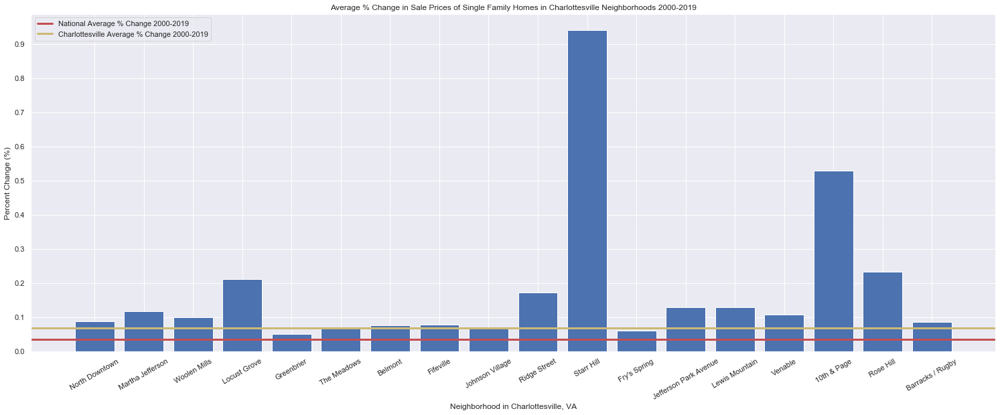

In [89]:
values=[]
yerrs=[]
for key in avg_pc:
    values.append(avg_pc.get(key)[0])
    yerrs.append(20*avg_pc.get(key)[1])
names=list(avg_pc.keys())
#values=list(avg_pc.values()[0])
fig=plt.figure()
axis=fig.add_axes([0,0,1,1])
#axis.bar(names,values, yerr=yerrs)
axis.bar(names,values)
plt.title('Average % Change in Sale Prices of Single Family Homes in Charlottesville Neighborhoods 2000-2019')
plt.ylabel('Percent Change (%)')
plt.xlabel('Neighborhood in Charlottesville, VA')
plt.xticks(rotation=30)
plt.yticks(np.arange(0,1,0.1))
plt.axhline(y=trends.pct_change()['National Average SaleAmount'].mean(), linewidth=3, color='r', label='National Average % Change 2000-2019')
plt.axhline(y=trends.pct_change()['Cville SaleAmount'].mean(), linewidth=3, color='y', label='Charlottesville Average % Change 2000-2019')
plt.legend(loc='upper left')
plt.savefig('neighborhood_trends.png', bbox_inches='tight')
plt.tight_layout()
plt.show()

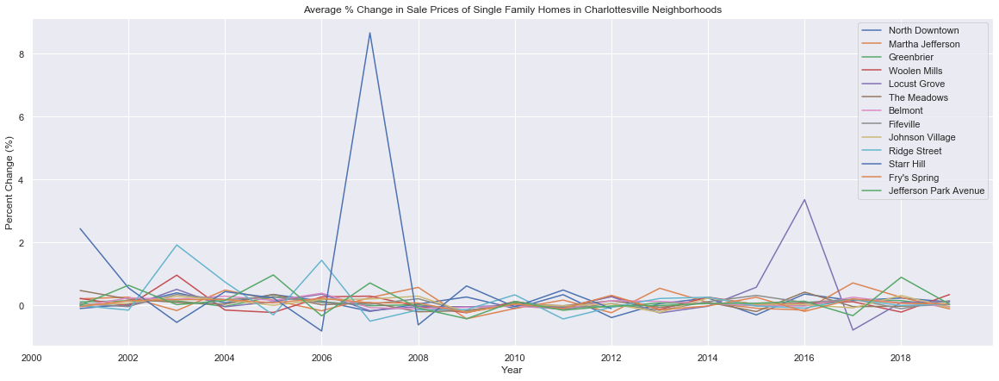

In [50]:
ax=nd_pc.plot(x='Year', y ='Neighborhood SaleAmount', label='North Downtown')
mj_pc.plot(x='Year', y='Neighborhood SaleAmount', ax=ax, label = 'Martha Jefferson')
green_pc.plot(x='Year', y='Neighborhood SaleAmount', ax=ax, label='Greenbrier')
wm_pc.plot(x='Year', y='Neighborhood SaleAmount', ax=ax,label='Woolen Mills')
lg_pc.plot(x='Year', y='Neighborhood SaleAmount', ax=ax,label='Locust Grove')
mead_pc.plot(x='Year', y='Neighborhood SaleAmount', ax=ax,label='The Meadows')
bel_pc.plot(x='Year', y='Neighborhood SaleAmount', ax=ax,label='Belmont')
fife_pc.plot(x='Year', y='Neighborhood SaleAmount', ax=ax,label='Fifeville')
jv_pc.plot(x='Year', y='Neighborhood SaleAmount', ax=ax,label='Johnson Village')
rs_pc.plot(x='Year', y='Neighborhood SaleAmount', ax=ax,label='Ridge Street')
sh_pc.plot(x='Year', y='Neighborhood SaleAmount', ax=ax,label='Starr Hill')
fry_pc.plot(x='Year', y='Neighborhood SaleAmount', ax=ax,label='Fry\'s Spring')
jpa_pc.plot(x='Year', y='Neighborhood SaleAmount', ax=ax,label='Jefferson Park Avenue')
ax.set_xticks(np.arange(2000,2020,step=2))
#plt.xticks(rotation=20)
plt.ylabel('Percent Change (%)')
plt.title('Average % Change in Sale Prices of Single Family Homes in Charlottesville Neighborhoods')
plt.savefig('ind_trends.png')
plt.show()


## Folium by Neighborhood

In [51]:
def generateBaseMap(default_location=[38.045486,-78.494286], default_zoom_start=12):
    base_map=folium.Map(location=default_location, control_scale=True,zoom_start=default_zoom_start)
    return base_map

In [81]:
def plot_g(df):    
    fg=folium.FeatureGroup(name='All Neighborhoods')
    m2.add_child(fg)
    
    g1 = plugins.FeatureGroupSubGroup(fg, 'North Downtown (Avg: $'+'{:,.2f}'.format(nd_df['SaleAmount'].mean())+')')
    m2.add_child(g1)

    g2 = plugins.FeatureGroupSubGroup(fg, 'Martha Jefferson (Avg: $'+'{:,.2f}'.format(mj_df['SaleAmount'].mean())+')')
    m2.add_child(g2)
    
    g3 = plugins.FeatureGroupSubGroup(fg, 'Woolen Mills (Avg: $'+'{:,.2f}'.format(wm_df['SaleAmount'].mean())+')')
    m2.add_child(g3)
    
    g4 = plugins.FeatureGroupSubGroup(fg, 'Locust Grove (Avg: $'+'{:,.2f}'.format(lg_df['SaleAmount'].mean())+')')
    m2.add_child(g4)

    g5 = plugins.FeatureGroupSubGroup(fg, 'Greenbrier (Avg: $'+'{:,.2f}'.format(green_df['SaleAmount'].mean())+')')
    m2.add_child(g5)
    
    g6 = plugins.FeatureGroupSubGroup(fg, 'The Meadows (Avg: $'+'{:,.2f}'.format(mead_df['SaleAmount'].mean())+')')
    m2.add_child(g6)
    
    g7 = plugins.FeatureGroupSubGroup(fg, 'Belmont (Avg: $'+'{:,.2f}'.format(bel_df['SaleAmount'].mean())+')')
    m2.add_child(g7)
    
    g8 = plugins.FeatureGroupSubGroup(fg, 'Fifeville (Avg: $'+'{:,.2f}'.format(fife_df['SaleAmount'].mean())+')')
    m2.add_child(g8)
    
    g9 = plugins.FeatureGroupSubGroup(fg, 'Johnson Village (Avg: $'+'{:,.2f}'.format(jv_df['SaleAmount'].mean())+')')
    m2.add_child(g9)
    
    g10 = plugins.FeatureGroupSubGroup(fg, 'Ridge Street (Avg: $'+'{:,.2f}'.format(rs_df['SaleAmount'].mean())+')')
    m2.add_child(g10)
   
    g11 = plugins.FeatureGroupSubGroup(fg, 'Starr Hill (Avg: $'+'{:,.2f}'.format(sh_df['SaleAmount'].mean())+')')
    m2.add_child(g11)
    
    g12 = plugins.FeatureGroupSubGroup(fg, 'Fry\'s Spring (Avg: $'+'{:,.2f}'.format(fry_df['SaleAmount'].mean())+')')
    m2.add_child(g12)
    
    g13 = plugins.FeatureGroupSubGroup(fg, 'Jefferson Park Avenue (Avg: $'+'{:,.2f}'.format(jpa_df['SaleAmount'].mean())+')')
    m2.add_child(g13)
    
    g14 = plugins.FeatureGroupSubGroup(fg, 'Lewis Mountain (Avg: $'+'{:,.2f}'.format(lewis_df['SaleAmount'].mean())+')')
    m2.add_child(g14)
    
    g15 = plugins.FeatureGroupSubGroup(fg, 'Venable (Avg: $'+'{:,.2f}'.format(ven_df['SaleAmount'].mean())+')')
    m2.add_child(g15)
    
    g16 = plugins.FeatureGroupSubGroup(fg, '10th & Page (Avg: $'+'{:,.2f}'.format(tenpage_df['SaleAmount'].mean())+')')
    m2.add_child(g16)
    
    g17 = plugins.FeatureGroupSubGroup(fg, 'Rose Hill (Avg: $'+'{:,.2f}'.format(rose_df['SaleAmount'].mean())+')')
    m2.add_child(g17)
    
    g18 = plugins.FeatureGroupSubGroup(fg, 'Barracks / Rugby (Avg: $'+'{:,.2f}'.format(barug_df['SaleAmount'].mean())+')')
    m2.add_child(g18)

    for index, row in sf20.iterrows():
        popup_text=str(row['Address'])+'\nSaleAmount: $'+'{:,.2f}'.format(row['SaleAmount'])
        if row['SaleAmount']<100000:
            color='#FEF001'   
        elif row['SaleAmount']>100000 and row['SaleAmount']<200000:
            color='#FD9A01'            
        elif row['SaleAmount']>200000 and row['SaleAmount']<350000:
            color='#orangered'             
        elif row['SaleAmount']>350000 and row['SaleAmount']<500000:
            color='#FF0000'             
        elif row['SaleAmount']>500000 and row['SaleAmount']<1000000:
            color='#B22222'            
        else:
            color = '#800000'        
        
        if row['Neighborhood']=='North Downtown':
            group=g1            
        elif row['Neighborhood']=='Martha Jefferson':
            group=g2       
        elif row['Neighborhood']=='Woolen Mills':
            group=g3          
        elif row['Neighborhood']=='Locust Grove':
            group=g4              
        elif row['Neighborhood']=='Greenbrier':
            group=g5
        elif row['Neighborhood']=='The Meadows':
            group=g6                           
        elif row['Neighborhood']=='Belmont':
            group=g7                           
        elif row['Neighborhood']=='Fifeville':
            group=g8                           
        elif row['Neighborhood']=='Johnson Village':
            group=g9                           
        elif row['Neighborhood']=='Ridge Street':
            group=g10                           
        elif row['Neighborhood']=='Starr Hill':
            group=g11                           
        elif row['Neighborhood']=='Fry\'s Spring':
            group=g12                           
        elif row['Neighborhood']=='Jefferson Park Avenue':
            group=g13                           
        elif row['Neighborhood']=='Lewis Mountain':
            group=g14                           
        elif row['Neighborhood']=='Venable':
            group=g15                           
        elif row['Neighborhood']=='10th & Page':
            group=g16                           
        elif row['Neighborhood']=='Rose Hill':
            group=g17                           
        elif row['Neighborhood']=='Barracks / Rugby':
            group=g18                           
        
        folium.CircleMarker(location=[row['Latitude'], row['Longitude']], radius = 2, color = color, popup=popup_text, fill=False,line_opacity=0.5).add_to(group)
        
    folium.LayerControl(collapsed=False).add_to(m2)

In [53]:
m2=generateBaseMap()
plot_g(sf20)
m2.save('html/colors_neighs.html')
m2

## Choropleth/GeoJson

In [54]:
n_data=pd.DataFrame(sf20['Neighborhood'].unique())
n_data.columns=['Neighborhood']
for index,row in n_data.iterrows():
    temp=sf20.loc[sf20.Neighborhood==row['Neighborhood']]
    n_data.at[index,'Avg. Sale Amount 2000-2019']=temp['SaleAmount'].mean()
    n_data.at[index,'Avg. % Change in Sale Amount']=avg_pc.get(row['Neighborhood'])[0]
n_data

,Neighborhood,Avg. Sale Amount 2000-2019,Avg. % Change in Sale Amount
0,Venable,457080.760504,0.107438
1,Barracks / Rugby,441144.540062,0.086479
2,Rose Hill,127370.537313,0.232730
3,10th & Page,264761.910394,0.530303
4,Lewis Mountain,538367.042553,0.129793
5,Jefferson Park Avenue,325610.295082,0.128803
6,Fry's Spring,266204.525346,0.061183
7,Johnson Village,299688.602180,0.066998
8,Fifeville,191641.219325,0.078361
9,Ridge Street,311907.223744,0.172127


In [120]:
n_data.loc[18]=['Barracks Road', np.NaN, np.NaN]
n_data

,Neighborhood,Avg. Sale Amount 2000-2019,Avg. % Change in Sale Amount
0,Venable,457080.760504,0.107438
1,Barracks / Rugby,441144.540062,0.086479
2,Rose Hill,127370.537313,0.232730
3,10th & Page,264761.910394,0.530303
4,Lewis Mountain,538367.042553,0.129793
5,Jefferson Park Avenue,325610.295082,0.128803
6,Fry's Spring,266204.525346,0.061183
7,Johnson Village,299688.602180,0.066998
8,Fifeville,191641.219325,0.078361
9,Ridge Street,311907.223744,0.172127


In [201]:
n_data.to_csv('csv/neighborhood_data.csv')

In [91]:
n_geojson = json.load(open('Planning_Neighborhood_Area.geojson'))

In [209]:
cloro=generateBaseMap()

#folium.LayerControl().add_to(cloro)


folium.Choropleth(
    geo_data=n_geojson,
    name='choropleth',
    data=n_data,
    columns=['Neighborhood','Avg. Sale Amount 2000-2019'],
    key_on='feature.properties.NAME',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.5,
    nan_fill_opacity=0,
    legend_name='Avg. Sale Price 2000-2019 ($)'
).add_to(cloro)

cloro.save('html/choropleth.html')
cloro

## Combining Folium Features
Choropleth and Markers

In [187]:
from branca.colormap import linear

m5=generateBaseMap()

groups=[g1,g2,g3,g4,g5,g6,g7,g8,g9,g10,g11,g12,g13,g14,g15,g16,g17,g18]

#fg=folium.FeatureGroup(name='All Neighborhoods')
#m5.add_child(fg)

g0=folium.FeatureGroup(name='choropleth',overlay=True).add_to(m5)

g1 = folium.FeatureGroup(name='North Downtown (Avg: $'+'{:,.2f}'.format(nd_df['SaleAmount'].mean())+')', overlay=True).add_to(m5)
#m5.add_child(g1)

g2 = folium.FeatureGroup(name='Martha Jefferson (Avg: $'+'{:,.2f}'.format(mj_df['SaleAmount'].mean())+')',overlay=True).add_to(m5)
#m5.add_child(g2)

g3 = folium.FeatureGroup(name='Woolen Mills (Avg: $'+'{:,.2f}'.format(wm_df['SaleAmount'].mean())+')',overlay=True).add_to(m5)
#m5.add_child(g3)

g4 = folium.FeatureGroup(name='Locust Grove (Avg: $'+'{:,.2f}'.format(lg_df['SaleAmount'].mean())+')',overlay=True).add_to(m5)
#m5.add_child(g4)

g5 = folium.FeatureGroup(name='Greenbrier (Avg: $'+'{:,.2f}'.format(green_df['SaleAmount'].mean())+')',overlay=True).add_to(m5)
#m5.add_child(g5)

g6 = folium.FeatureGroup(name='The Meadows (Avg: $'+'{:,.2f}'.format(mead_df['SaleAmount'].mean())+')',overlay=True).add_to(m5)
#m5.add_child(g6)

g7 = folium.FeatureGroup(name='Belmont (Avg: $'+'{:,.2f}'.format(bel_df['SaleAmount'].mean())+')',overlay=True).add_to(m5)
#m5.add_child(g7)

g8 = folium.FeatureGroup(name='Fifeville (Avg: $'+'{:,.2f}'.format(fife_df['SaleAmount'].mean())+')',overlay=True).add_to(m5)
#m5.add_child(g8)

g9 = folium.FeatureGroup(name='Johnson Village (Avg: $'+'{:,.2f}'.format(jv_df['SaleAmount'].mean())+')',overlay=True).add_to(m5)
#m5.add_child(g9)

g10 = folium.FeatureGroup(name='Ridge Street (Avg: $'+'{:,.2f}'.format(rs_df['SaleAmount'].mean())+')',overlay=True).add_to(m5)
#m5.add_child(g10)

g11 = folium.FeatureGroup(name='Starr Hill (Avg: $'+'{:,.2f}'.format(sh_df['SaleAmount'].mean())+')',overlay=True).add_to(m5)
#m5.add_child(g11)

g12 = folium.FeatureGroup(name='Fry\'s Spring (Avg: $'+'{:,.2f}'.format(fry_df['SaleAmount'].mean())+')',overlay=True).add_to(m5)
#m5.add_child(g12)

g13 = folium.FeatureGroup(name='Jefferson Park Avenue (Avg: $'+'{:,.2f}'.format(jpa_df['SaleAmount'].mean())+')',overlay=True).add_to(m5)
#m5.add_child(g13)

g14 = folium.FeatureGroup(name='Lewis Mountain (Avg: $'+'{:,.2f}'.format(lewis_df['SaleAmount'].mean())+')',overlay=True).add_to(m5)
#m5.add_child(g14)

g15 = folium.FeatureGroup(name='Venable (Avg: $'+'{:,.2f}'.format(ven_df['SaleAmount'].mean())+')',overlay=True).add_to(m5)
#m5.add_child(g15)

g16 = folium.FeatureGroup(name='10th & Page (Avg: $'+'{:,.2f}'.format(tenpage_df['SaleAmount'].mean())+')',overlay=True).add_to(m5)
#m5.add_child(g16)

g17 = folium.FeatureGroup(name='Rose Hill (Avg: $'+'{:,.2f}'.format(rose_df['SaleAmount'].mean())+')',overlay=True).add_to(m5)
#m5.add_child(g17)

g18 = folium.FeatureGroup(name='Barracks/Rugby (Avg: $'+'{:,.2f}'.format(barug_df['SaleAmount'].mean())+')',overlay=True).add_to(m5)
#m5.add_child(g18)

choro=folium.Choropleth(
    geo_data=n_geojson,
    name='choropleth',
    data=n_data,
    columns=['Neighborhood','Avg. Sale Amount 2000-2019'],
    key_on='feature.properties.NAME',
    fill_color='YlOrRd',
    fill_opacity=0.7,
    line_opacity=0.5,
    nan_fill_opacity=0,
    legend_name='Avg. Sale Price 2000-2019'
).geojson.add_to(g0)

geojson1=folium.GeoJson(data=n_geojson,
                        name='neighborhoods',
                        smooth_factor=2,
                        style_function=lambda x:{'color': 'black', 'fillColor':'transparent','weight':0.5},
                        tooltip=folium.GeoJsonTooltip(fields=['NAME'],
                                                    labels=False,
                                                    sticky=True),
                        highlight_function=lambda x:{'weight':3, 'fillColor':'grey'}).add_to(choro)



for index, row in sf20.iterrows():
    popup_text=str(row['Address'])+'\nSaleAmount: $'+'{:,.2f}'.format(row['SaleAmount'])
    if row['SaleAmount']<100000:
        color='#FEF001'   
    elif row['SaleAmount']>100000 and row['SaleAmount']<200000:
        color='#FD9A01'            
    elif row['SaleAmount']>200000 and row['SaleAmount']<350000:
        color='#orangered'             
    elif row['SaleAmount']>350000 and row['SaleAmount']<500000:
        color='#FF0000'             
    elif row['SaleAmount']>500000 and row['SaleAmount']<1000000:
        color='#B22222'            
    else:
        color = '#800000'        

    if row['Neighborhood']=='North Downtown':
        group=g1            
    elif row['Neighborhood']=='Martha Jefferson':
        group=g2       
    elif row['Neighborhood']=='Woolen Mills':
        group=g3          
    elif row['Neighborhood']=='Locust Grove':
        group=g4              
    elif row['Neighborhood']=='Greenbrier':
        group=g5
    elif row['Neighborhood']=='The Meadows':
        group=g6                           
    elif row['Neighborhood']=='Belmont':
        group=g7                           
    elif row['Neighborhood']=='Fifeville':
        group=g8                           
    elif row['Neighborhood']=='Johnson Village':
        group=g9                           
    elif row['Neighborhood']=='Ridge Street':
        group=g10                           
    elif row['Neighborhood']=='Starr Hill':
        group=g11                           
    elif row['Neighborhood']=='Fry\'s Spring':
        group=g12                           
    elif row['Neighborhood']=='Jefferson Park Avenue':
        group=g13                           
    elif row['Neighborhood']=='Lewis Mountain':
        group=g14                           
    elif row['Neighborhood']=='Venable':
        group=g15                           
    elif row['Neighborhood']=='10th & Page':
        group=g16                           
    elif row['Neighborhood']=='Rose Hill':
        group=g17                           
    elif row['Neighborhood']=='Barracks / Rugby':
        group=g18                           

    folium.CircleMarker(location=[row['Latitude'], row['Longitude']], radius = 2, color = color, popup=popup_text, fill=False,line_opacity=0.5).add_to(group)
        
colormap=linear.YlOrRd_09.scale(100000,600000)
colormap.caption='Avg. Sale Price 2000-2019 (US $)'
colormap.add_to(m5)

#folium.TileLayer('cartodbdark_matter', overlay=False, name='dark mode', attr='https://cartodb.com/').add_to(m5)
folium.TileLayer('cartodbpositron', show=True,overlay=False,name='light mode', attr='https://cartodb.com/').add_to(m5)
        
folium.LayerControl(collapsed=False).add_to(m5)
m5.save('html/choro_markers.html')
m5

Neighborhood Boundaries and Markers

In [200]:
from branca.colormap import linear

m6=generateBaseMap()


g1 = folium.FeatureGroup(name='North Downtown (Avg: $'+'{:,.2f}'.format(nd_df['SaleAmount'].mean())+')', overlay=True).add_to(m6)
#m6.add_child(g1)

g2 = folium.FeatureGroup(name='Martha Jefferson (Avg: $'+'{:,.2f}'.format(mj_df['SaleAmount'].mean())+')',overlay=True).add_to(m6)
#m6.add_child(g2)

g3 = folium.FeatureGroup(name='Woolen Mills (Avg: $'+'{:,.2f}'.format(wm_df['SaleAmount'].mean())+')',overlay=True).add_to(m6)
#m6.add_child(g3)

g4 = folium.FeatureGroup(name='Locust Grove (Avg: $'+'{:,.2f}'.format(lg_df['SaleAmount'].mean())+')',overlay=True).add_to(m6)
#m6.add_child(g4)

g5 = folium.FeatureGroup(name='Greenbrier (Avg: $'+'{:,.2f}'.format(green_df['SaleAmount'].mean())+')',overlay=True).add_to(m6)
#m6.add_child(g5)

g6 = folium.FeatureGroup(name='The Meadows (Avg: $'+'{:,.2f}'.format(mead_df['SaleAmount'].mean())+')',overlay=True).add_to(m6)
#m6.add_child(g6)

g7 = folium.FeatureGroup(name='Belmont (Avg: $'+'{:,.2f}'.format(bel_df['SaleAmount'].mean())+')',overlay=True).add_to(m6)
#m6.add_child(g7)

g8 = folium.FeatureGroup(name='Fifeville (Avg: $'+'{:,.2f}'.format(fife_df['SaleAmount'].mean())+')',overlay=True).add_to(m6)
#m6.add_child(g8)

g9 = folium.FeatureGroup(name='Johnson Village (Avg: $'+'{:,.2f}'.format(jv_df['SaleAmount'].mean())+')',overlay=True).add_to(m6)
#m6.add_child(g9)

g10 = folium.FeatureGroup(name='Ridge Street (Avg: $'+'{:,.2f}'.format(rs_df['SaleAmount'].mean())+')',overlay=True).add_to(m6)
#m6.add_child(g10)

g11 = folium.FeatureGroup(name='Starr Hill (Avg: $'+'{:,.2f}'.format(sh_df['SaleAmount'].mean())+')',overlay=True).add_to(m6)
#m6.add_child(g11)

g12 = folium.FeatureGroup(name='Fry\'s Spring (Avg: $'+'{:,.2f}'.format(fry_df['SaleAmount'].mean())+')',overlay=True).add_to(m6)
#m6.add_child(g12)

g13 = folium.FeatureGroup(name='Jefferson Park Avenue (Avg: $'+'{:,.2f}'.format(jpa_df['SaleAmount'].mean())+')',overlay=True).add_to(m6)
#m6.add_child(g13)

g14 = folium.FeatureGroup(name='Lewis Mountain (Avg: $'+'{:,.2f}'.format(lewis_df['SaleAmount'].mean())+')',overlay=True).add_to(m6)
#m6.add_child(g14)

g15 = folium.FeatureGroup(name='Venable (Avg: $'+'{:,.2f}'.format(ven_df['SaleAmount'].mean())+')',overlay=True).add_to(m6)
#m6.add_child(g15)

g16 = folium.FeatureGroup(name='10th & Page (Avg: $'+'{:,.2f}'.format(tenpage_df['SaleAmount'].mean())+')',overlay=True).add_to(m6)
#m6.add_child(g16)

g17 = folium.FeatureGroup(name='Rose Hill (Avg: $'+'{:,.2f}'.format(rose_df['SaleAmount'].mean())+')',overlay=True).add_to(m6)
#m6.add_child(g17)

g18 = folium.FeatureGroup(name='Barracks/Rugby (Avg: $'+'{:,.2f}'.format(barug_df['SaleAmount'].mean())+')',overlay=True).add_to(m6)
#m6.add_child(g18)



geojson1=folium.GeoJson(data=n_geojson,
                        name='Show Neighborhoods',
                        smooth_factor=2,
                        style_function=lambda x:{'color': 'black', 'fillColor':'transparent','weight':1.5},
                        tooltip=folium.GeoJsonTooltip(fields=['NAME'],
                                                    labels=False,
                                                    sticky=True),
                        highlight_function=lambda x:{'weight':3, 'fillColor':'grey'}).add_to(m6)





for index, row in sf20.iterrows():
    popup_text=str(row['Address'])+'\nSaleAmount: $'+'{:,.2f}'.format(row['SaleAmount'])
    if row['SaleAmount']<100000:
        color='#FEF001'   
    elif row['SaleAmount']>100000 and row['SaleAmount']<200000:
        color='#FD9A01'            
    elif row['SaleAmount']>200000 and row['SaleAmount']<350000:
        color='#orangered'             
    elif row['SaleAmount']>350000 and row['SaleAmount']<500000:
        color='#FF0000'             
    elif row['SaleAmount']>500000 and row['SaleAmount']<1000000:
        color='#B22222'            
    else:
        color = '#800000'        

    if row['Neighborhood']=='North Downtown':
        group=g1            
    elif row['Neighborhood']=='Martha Jefferson':
        group=g2       
    elif row['Neighborhood']=='Woolen Mills':
        group=g3          
    elif row['Neighborhood']=='Locust Grove':
        group=g4              
    elif row['Neighborhood']=='Greenbrier':
        group=g5
    elif row['Neighborhood']=='The Meadows':
        group=g6                           
    elif row['Neighborhood']=='Belmont':
        group=g7                           
    elif row['Neighborhood']=='Fifeville':
        group=g8                           
    elif row['Neighborhood']=='Johnson Village':
        group=g9                           
    elif row['Neighborhood']=='Ridge Street':
        group=g10                           
    elif row['Neighborhood']=='Starr Hill':
        group=g11                           
    elif row['Neighborhood']=='Fry\'s Spring':
        group=g12                           
    elif row['Neighborhood']=='Jefferson Park Avenue':
        group=g13                           
    elif row['Neighborhood']=='Lewis Mountain':
        group=g14                           
    elif row['Neighborhood']=='Venable':
        group=g15                           
    elif row['Neighborhood']=='10th & Page':
        group=g16                           
    elif row['Neighborhood']=='Rose Hill':
        group=g17                           
    elif row['Neighborhood']=='Barracks / Rugby':
        group=g18                           

    folium.CircleMarker(location=[row['Latitude'], row['Longitude']], radius = 1.5, color = color, popup=popup_text, fill=False,line_opacity=0.5).add_to(group)
        
#folium.TileLayer('cartodbdark_matter', overlay=False, name='dark mode', attr='https://cartodb.com/').add_to(m6)
folium.TileLayer('cartodbpositron', show=True,overlay=False,name='light mode', attr='https://cartodb.com/').add_to(m6)
        
folium.LayerControl(collapsed=False).add_to(m6)
m6.save('html/markers_neighs.html')
m6